In [1]:
import kagglehub
alkanerturan_vehicledetection_path = kagglehub.dataset_download('alkanerturan/vehicledetection')

print('Data source import complete.')


Data source import complete.


 <p style="padding:10px;background-color:white;margin:200;color:black;font-family:newtimeroman;font-size:400%;text-align:center;border-radius: 1500px 500px;overflow:hidden;font-weight:8000">🚓 Vehicle Detection 🚓 </p>

 <p style="color:navy;font-family:newtimeroman;font-size:500%;text-align:center; font-weight:8000">🏁Lets get started🏁</p>

<p style="color:navy; font-family:'Times New Roman'; font-size:200%; font-weight:bold; text-align:left;"><strong>Introduction</strong></p>

<p style="color:black; font-family:'Times New Roman'; font-size:130%; text-align:justify; line-height:1.6;">
This project aims to develop a robust <strong>YOLOv11-based object detection model</strong> specifically tailored for vehicle recognition in real-world scenarios. The primary objective is to accurately detect and classify five key vehicle types: <em>ambulances, buses, cars, motorcycles, and trucks</em>, using a custom dataset annotated in YOLO format.
</p>

<p style="color:black; font-family:'Times New Roman'; font-size:130%; text-align:justify; line-height:1.6;">
The workflow begins with <strong>training a YOLO model from scratch</strong>, allowing full control over the architecture and learning dynamics. If the results fall short of expectations, we will then adopt a <strong>transfer learning</strong> strategy, leveraging pretrained weights to improve performance and convergence speed.
</p>

<p style="color:black; font-family:'Times New Roman'; font-size:130%; text-align:justify; line-height:1.6;">
The final model is expected to contribute effectively to real-world applications such as <strong>traffic monitoring</strong>, <strong>autonomous vehicle navigation</strong>, and <strong>smart surveillance systems</strong>. By accurately identifying and localizing vehicles in various conditions, it supports critical tasks in intelligent transportation infrastructure.
</p>


# <p style="padding:20px;background-color:black;margin:0;color:yellow;font-family:newtimeroman;font-size:120%;text-align:center;border-radius: 15px 500px;overflow:hidden;font-weight:800">🏁 Step 1 | Setup and Initialization</p>

In [2]:
!pip install ultralytics

   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 1.0/1.0 MB 29.1 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 363.4/363.4 MB 3.9 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 13.8/13.8 MB 115.7 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 24.6/24.6 MB 95.7 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 883.7/883.7 kB 57.1 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 664.8/664.8 MB 2.4 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 211.5/211.5 MB 5.8 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 56.3/56.3 MB 15.2 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 127.9/127.9 MB 7.5 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 207.5/207.5 MB 5.7 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 21.1/21.1 MB 94.1 MB/s eta 0:00:00
  Attempting uninstall: nvidia-nvjitlink-cu12
    Found existing installation: nvidia-nvjitlink-cu12 12.5.82
    Uninstalling

In [3]:
!pip install supervision

   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 206.7/206.7 kB 5.3 MB/s eta 0:00:00


In [4]:
# Disable warnings in the notebook to maintain clean output cells
import warnings
warnings.filterwarnings('ignore')
import os
import shutil
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
import yaml
import cv2
import supervision as sv
from ultralytics import YOLO
import copy
from pathlib import Path
import torch
import torch.nn as nn
from torchvision.models.feature_extraction import create_feature_extractor
from collections import OrderedDict
from torchvision.ops.feature_pyramid_network import FeaturePyramidNetwork
from torchvision.models.detection.anchor_utils import AnchorGenerator
import torchvision
import torch.optim as optim
from tqdm import tqdm
from torchvision.ops import nms
import torchvision.transforms as T
from torchvision.ops.boxes import box_iou
from torch.utils.data import DataLoader
import xml.etree.ElementTree as ET
import torchvision
import cv2
import random
from PIL import Image
from collections import Counter
import torchvision.transforms.functional as F
from collections import Counter
from IPython.display import Video

Creating new Ultralytics Settings v0.0.6 file ✅ 
View Ultralytics Settings with 'yolo settings' or at '/root/.config/Ultralytics/settings.json'
Update Settings with 'yolo settings key=value', i.e. 'yolo settings runs_dir=path/to/dir'. For help see https://docs.ultralytics.com/quickstart/#ultralytics-settings.


# <p style="padding:20px;background-color:black;margin:0;color:yellow;font-family:newtimeroman;font-size:120%;text-align:center;border-radius: 15px 500px;overflow:hidden;font-weight:800">👀 Step 2  | Dataset Overview </p>

 <p style="color:navy;font-family:newtimeroman;font-size:250%;text-align:center; font-weight:8000"> 🔎 lets see the RAW images and their labels 🔎 </p>

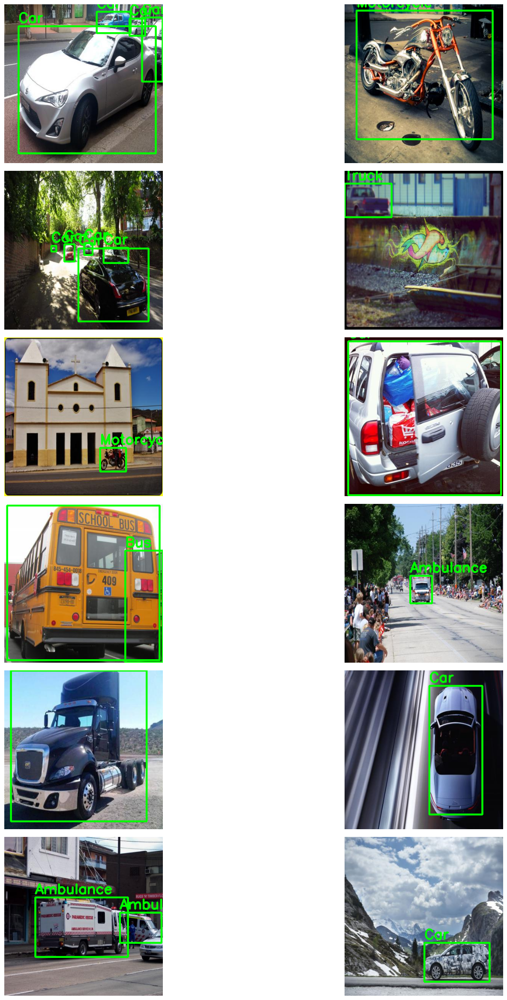

In [5]:
from pathlib import Path
import random
import matplotlib.pyplot as plt
import cv2

base_path = Path(alkanerturan_vehicledetection_path) / "VehiclesDetectionDataset"
train_images = base_path / 'train/images'
train_labels = base_path / 'train/labels'
class_names = ['Ambulance', 'Bus', 'Car', 'Motorcycle', 'Truck']

def JPG_Name_To_TXT(image_name):
    """Convert image filename to corresponding YOLO label filename."""
    return image_name.rsplit('.', 1)[0] + ".txt"

def get_image_dimensions(img_path):
    """Returns height and width of an image."""
    img = cv2.imread(str(img_path))
    return img.shape[:2]  # (height, width)

def TXT_To_BBOX(txt_path, img_height, img_width):
    """Reads YOLO format TXT and converts it to (x_min, y_min, x_max, y_max, class_id)."""
    bboxes = []
    with open(txt_path, "r") as f:
        for line in f:
            parts = line.strip().split()
            class_id = int(parts[0])
            x_center, y_center, width, height = map(float, parts[1:])
            x_min = int((x_center - width / 2) * img_width)
            y_min = int((y_center - height / 2) * img_height)
            x_max = int((x_center + width / 2) * img_width)
            y_max = int((y_center + height / 2) * img_height)
            bboxes.append((x_min, y_min, x_max, y_max, class_id))
    return bboxes

def Plot_Random_Images():
    """Randomly selects images and plots them with their bounding boxes."""
    random_images = random.choices(list(train_images.iterdir()), k=12)
    plt.figure(figsize=(20, 30))

    for i, img_path in enumerate(random_images, 1):
        plt.subplot(6, 2, i)
        img = cv2.imread(str(img_path))
        img = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)
        txt_name = JPG_Name_To_TXT(img_path.name)
        lbl_path = train_labels / txt_name

        if lbl_path.exists():
            img_height, img_width = get_image_dimensions(img_path)
            bboxes = TXT_To_BBOX(lbl_path, img_height, img_width)

            for (x_min, y_min, x_max, y_max, class_id) in bboxes:
                color = (0, 255, 0)
                cv2.rectangle(img, (x_min, y_min), (x_max, y_max), color, 3)
                cv2.putText(
                    img,
                    f"{class_names[class_id]}",
                    (x_min, y_min - 10),
                    cv2.FONT_HERSHEY_SIMPLEX,
                    1.2,
                    color,
                    3
                )

        plt.imshow(img)
        plt.axis('off')

    plt.subplots_adjust(wspace=0.05, hspace=0.05)
    plt.show()

# Run the function
Plot_Random_Images()


In [6]:
import os

# Print the directory structure to find correct subfolders
for root, dirs, files in os.walk(alkanerturan_vehicledetection_path):
    print("🔍", root)
    for d in dirs:
        print("📁", d)
    for f in files[:5]:
        print("📄", f)


🔍 /kaggle/input/vehicledetection
📁 VehiclesDetectionDataset
📁 TestVideo
🔍 /kaggle/input/vehicledetection/VehiclesDetectionDataset
📁 valid
📁 test
📁 train
📄 dataset.yaml
🔍 /kaggle/input/vehicledetection/VehiclesDetectionDataset/valid
📁 labels
📁 images
🔍 /kaggle/input/vehicledetection/VehiclesDetectionDataset/valid/labels
📄 96fa09e7f79763dc_jpg.rf.RzdNdxT5bnlgUfDD9dIW.txt
📄 34f6a140cae07ad1_jpg.rf.PTlOe1oBTOfqadeQiqrx.txt
📄 45dc77695b432d4a_jpg.rf.jM8iOxruIzzDX9VCZejE.txt
📄 080a59534ba7d557_jpg.rf.7d43b48f7b72a761a19b21e6c3367403.txt
📄 0013d97a44c586c0_jpg.rf.c129e0f75e464334397783e12eeddd69.txt
🔍 /kaggle/input/vehicledetection/VehiclesDetectionDataset/valid/images
📄 4046b4261847fad4_jpg.rf.Pu8ZmWKhSQ9UmJVGH0o4.jpg
📄 9d3c9b88e091fd93_jpg.rf.IxrcQGvIXzqW3AQSsouh.jpg
📄 0053860714da4340_jpg.rf.W5imfEtsa9yRvs4xbBiq.jpg
📄 041172adfae5695a_jpg.rf.1fbb787bac32648e8bf6dad3d0fe4157.jpg
📄 56eaa673deaa0765_jpg.rf.jM9uO1SAKdxUfELrvpBc.jpg
🔍 /kaggle/input/vehicledetection/VehiclesDetectionDataset/test

 <p style="color:navy;font-family:newtimeroman;font-size:250%;text-align:center; font-weight:8000"> 🟡 Count plot of classes 🟡 </p>

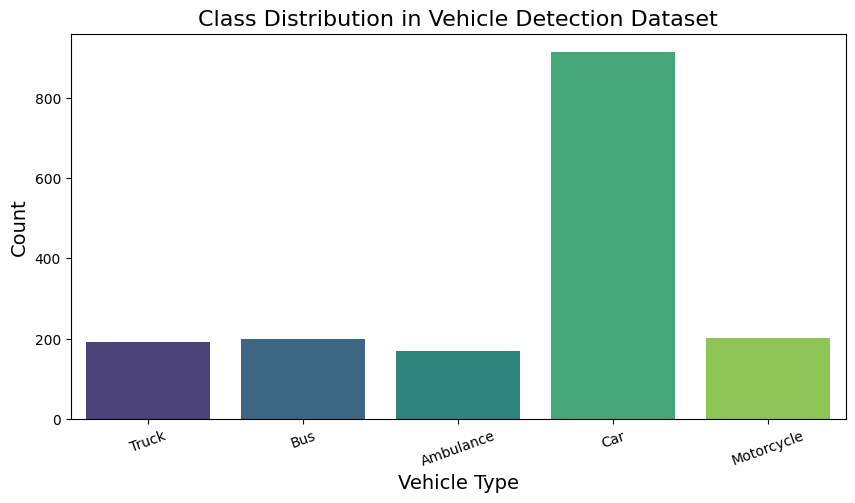

In [7]:
def Count_Classes():
    """
    Reads all label files and counts the occurrences of each class.
    """
    class_counts = Counter()

    # Loop through all label files
    for lbl_path in train_labels.iterdir():
        with open(lbl_path, 'r') as f:
            lines = f.readlines()
            for line in lines:
                class_id = int(line.strip().split()[0])  # Extract class ID
                class_counts[class_names[class_id]] += 1  # Increment count

    # Plot countplot
    plt.figure(figsize=(10, 5))
    sns.barplot(x=list(class_counts.keys()), y=list(class_counts.values()), palette="viridis")
    plt.xlabel("Vehicle Type", fontsize=14)
    plt.ylabel("Count", fontsize=14)
    plt.title("Class Distribution in Vehicle Detection Dataset", fontsize=16)
    plt.xticks(rotation=20)  # Rotate labels for better readability
    plt.show()

Count_Classes()


# <p style="padding:20px;background-color:black;margin:0;color:yellow;font-family:newtimeroman;font-size:120%;text-align:center;border-radius: 15px 500px;overflow:hidden;font-weight:800">🌘 Step 3  | Protorype Detection </p>

100%|██████████| 18.4M/18.4M [00:00<00:00, 90.3MB/s]



image 1/1 /kaggle/input/vehicledetection/VehiclesDetectionDataset/train/images/ee2cd94b9d7fdba0_jpg.rf.lzKF7lMc5Ew1qKAsxJ6R.jpg: 416x416 1 car, 29.4ms
Speed: 2.0ms preprocess, 29.4ms inference, 334.5ms postprocess per image at shape (1, 3, 416, 416)

image 1/1 /kaggle/input/vehicledetection/VehiclesDetectionDataset/train/images/48763535bbf4e21f_jpg.rf.a54cf5898534d815db2159ffd1b2393b.jpg: 416x416 3 persons, 3 suitcases, 10.5ms
Speed: 0.9ms preprocess, 10.5ms inference, 1.9ms postprocess per image at shape (1, 3, 416, 416)

image 1/1 /kaggle/input/vehicledetection/VehiclesDetectionDataset/train/images/62095bcc48bd06cf_jpg.rf.N0JRNsP7kKtTF56RrIOM.jpg: 416x416 2 cars, 14.3ms
Speed: 1.3ms preprocess, 14.3ms inference, 2.1ms postprocess per image at shape (1, 3, 416, 416)

image 1/1 /kaggle/input/vehicledetection/VehiclesDetectionDataset/train/images/ccda9fe055e7fb14_jpg.rf.qpuvhah7Z8cihR1hXZXD.jpg: 416x416 1 person, 1 bus, 10.7ms
Speed: 0.9ms preprocess, 10.7ms inference, 1.4ms postproces

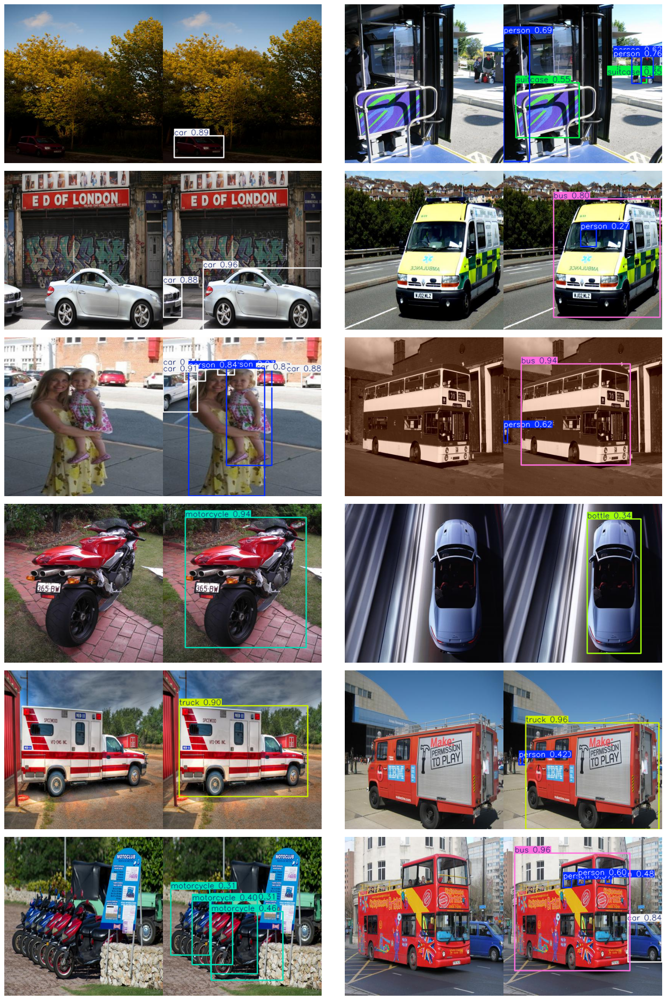

In [8]:
import os
import random
import numpy as np
import matplotlib.pyplot as plt
import cv2
from PIL import Image
from ultralytics import YOLO

# Define correct image folder path based on kagglehub path
images_folder = os.path.join(alkanerturan_vehicledetection_path, 'VehiclesDetectionDataset', 'train', 'images')

# Get image file list
image_files = [f for f in os.listdir(images_folder) if f.endswith(('.jpg', '.png', '.jpeg'))]

# Select 12 random images
random_images = random.sample(image_files, 12)

# Load YOLOv11 model
model = YOLO("yolo11s.pt")

# Set up plot layout
fig, axes = plt.subplots(6, 2, figsize=(20, 30))
axes = axes.flatten()

# Process and plot images
for i, image_file in enumerate(random_images):
    image_path = os.path.join(images_folder, image_file)

    # Run YOLO prediction
    result_predict = model.predict(source=image_path, imgsz=416)

    # Load original image
    original_image = Image.open(image_path).convert("RGB")
    original_array = np.array(original_image)

    # Get YOLO-predicted image
    for result in result_predict:
        plot = result.plot()
        plot = cv2.cvtColor(plot, cv2.COLOR_BGR2RGB)

    # Combine original and predicted image side by side
    combined_image = np.hstack((original_array, plot))

    # Display the image
    axes[i].imshow(combined_image)
    axes[i].axis('off')

# Adjust spacing
plt.subplots_adjust(wspace=0.05, hspace=0.05)
plt.show()


 <p style="color:black;font-family:newtimeroman;font-size:250%;text-align:center; font-weight:8000">✅ we already get suitable results with YOLO11 original weight(coco dataset) without training,and its gives us a reason that we can use Transfer learning to reach optimal results,BUT first let build a yolo model from scrach to see what will happen ✅ </p>

# <p style="padding:20px;background-color:black;margin:0;color:yellow;font-family:newtimeroman;font-size:120%;text-align:center;border-radius: 15px 500px;overflow:hidden;font-weight:800">🌗 Step 4  | YOLO11 from Scrach </p>

 <p style="color:navy;font-family:newtimeroman;font-size:200%;text-align:left; font-weight:8000"> 📽 Create YAML file. </p>

In [9]:
import os
import yaml

# Define the correct dataset path
dataset_path = os.path.join(alkanerturan_vehicledetection_path, 'VehiclesDetectionDataset')

# Set the path to the YAML file
yaml_file_path = os.path.join(dataset_path, 'dataset.yaml')

# Load and print the contents of the YAML file
with open(yaml_file_path, 'r') as file:
    yaml_content = yaml.load(file, Loader=yaml.FullLoader)
    print(yaml.dump(yaml_content, default_flow_style=False))


names:
- Ambulance
- Bus
- Car
- Motorcycle
- Truck
nc: 5
test: ../test/images
train: ../train/images
val: ../valid/images



 <p style="color:navy;font-family:newtimeroman;font-size:200%;text-align:left; font-weight:8000"> 👓 Count and resolution of Images. </p>

In [10]:
# Set paths for training and validation image sets
train_images_path = os.path.join(dataset_path, 'train', 'images')
valid_images_path = os.path.join(dataset_path, 'valid', 'images')

# Initialize counters for the number of images
num_train_images = 0
num_valid_images = 0

# Initialize sets to hold the unique sizes of images
train_image_sizes = set()
valid_image_sizes = set()

# Check train images sizes and count
for filename in os.listdir(train_images_path):
    if filename.endswith('.jpg'):
        num_train_images += 1
        image_path = os.path.join(train_images_path, filename)
        with Image.open(image_path) as img:
            train_image_sizes.add(img.size)

# Check validation images sizes and count
for filename in os.listdir(valid_images_path):
    if filename.endswith('.jpg'):
        num_valid_images += 1
        image_path = os.path.join(valid_images_path, filename)
        with Image.open(image_path) as img:
            valid_image_sizes.add(img.size)

# Print the results
print(f"Number of training images: {num_train_images}")
print(f"Number of validation images: {num_valid_images}")

# Check if all images in training set have the same size
if len(train_image_sizes) == 1:
    print(f"All training images have the same size: {train_image_sizes.pop()}")
else:
    print("Training images have varying sizes.")

# Check if all images in validation set have the same size
if len(valid_image_sizes) == 1:
    print(f"All validation images have the same size: {valid_image_sizes.pop()}")
else:
    print("Validation images have varying sizes.")

Number of training images: 878
Number of validation images: 250
All training images have the same size: (416, 416)
All validation images have the same size: (416, 416)


![SSD Performance Evaluation — Mozilla Firefox 2_17_2025 5_35_02 PM.png](attachment:f5c25538-e759-4704-ac5a-7c83fbfe1517.png)

In [11]:
model = YOLO("yolo11n.pt")

100%|██████████| 5.35M/5.35M [00:00<00:00, 99.2MB/s]


In [12]:
# Train the model on our custom dataset
results = model.train(
    data=yaml_file_path,     # Path to the dataset configuration file
    epochs=120,              # Number of epochs to train for
    imgsz=416,               # Size of input images as integer
    device=0,                # Device to run on, i.e. cuda device=0
    patience=150,             # Epochs to wait for no observable improvement for early stopping of training
    batch=32,                # Number of images per batch
    optimizer='auto',        # Optimizer to use, choices=[SGD, Adam, Adamax, AdamW, NAdam, RAdam, RMSProp, auto]
    lr0=0.001,              # Initial learning rate
    lrf=0.1,                 # Final learning rate (lr0 * lrf)
    dropout=0.3,             # Automatically restore best model# Use dropout regularization
    #freeze=20,               # first lets build from scrach
    seed=0                   # Random seed for reproducibility
)

Ultralytics 8.3.167 🚀 Python-3.11.13 torch-2.6.0+cu124 CUDA:0 (Tesla T4, 15095MiB)
engine/trainer: agnostic_nms=False, amp=True, augment=False, auto_augment=randaugment, batch=32, bgr=0.0, box=7.5, cache=False, cfg=None, classes=None, close_mosaic=10, cls=0.5, conf=None, copy_paste=0.0, copy_paste_mode=flip, cos_lr=False, cutmix=0.0, data=/kaggle/input/vehicledetection/VehiclesDetectionDataset/dataset.yaml, degrees=0.0, deterministic=True, device=0, dfl=1.5, dnn=False, dropout=0.3, dynamic=False, embed=None, epochs=120, erasing=0.4, exist_ok=False, fliplr=0.5, flipud=0.0, format=torchscript, fraction=1.0, freeze=None, half=False, hsv_h=0.015, hsv_s=0.7, hsv_v=0.4, imgsz=416, int8=False, iou=0.7, keras=False, kobj=1.0, line_width=None, lr0=0.001, lrf=0.1, mask_ratio=4, max_det=300, mixup=0.0, mode=train, model=yolo11n.pt, momentum=0.937, mosaic=1.0, multi_scale=False, name=train, nbs=64, nms=False, opset=None, optimize=False, optimizer=auto, overlap_mask=True, patience=150, perspective=

100%|██████████| 755k/755k [00:00<00:00, 17.9MB/s]

Overriding model.yaml nc=80 with nc=5

                   from  n    params  module                                       arguments                     
  0                  -1  1       464  ultralytics.nn.modules.conv.Conv             [3, 16, 3, 2]                 
  1                  -1  1      4672  ultralytics.nn.modules.conv.Conv             [16, 32, 3, 2]                
  2                  -1  1      6640  ultralytics.nn.modules.block.C3k2            [32, 64, 1, False, 0.25]      
  3                  -1  1     36992  ultralytics.nn.modules.conv.Conv             [64, 64, 3, 2]                
  4                  -1  1     26080  ultralytics.nn.modules.block.C3k2            [64, 128, 1, False, 0.25]     
  5                  -1  1    147712  ultralytics.nn.modules.conv.Conv             [128, 128, 3, 2]              
  6                  -1  1     87040  ultralytics.nn.modules.block.C3k2            [128, 128, 1, True]           
  7                  -1  1    295424  ultralytics

YOLO11n summary: 181 layers, 2,590,815 parameters, 2,590,799 gradients, 6.4 GFLOPs

Transferred 448/499 items from pretrained weights
Freezing layer 'model.23.dfl.conv.weight'
AMP: running Automatic Mixed Precision (AMP) checks...
AMP: checks passed ✅
train: Fast image access ✅ (ping: 0.1±0.1 ms, read: 93.2±26.4 MB/s, size: 29.7 KB)


train: Scanning /kaggle/input/vehicledetection/VehiclesDetectionDataset/train/labels... 878 images, 0 backgrounds, 0 corrupt: 100%|██████████| 878/878 [00:01<00:00, 560.38it/s]

WARNING ⚠️ train: Cache directory /kaggle/input/vehicledetection/VehiclesDetectionDataset/train is not writeable, cache not saved.


albumentations: Blur(p=0.01, blur_limit=(3, 7)), MedianBlur(p=0.01, blur_limit=(3, 7)), ToGray(p=0.01, method='weighted_average', num_output_channels=3), CLAHE(p=0.01, clip_limit=(1.0, 4.0), tile_grid_size=(8, 8))
val: Fast image access ✅ (ping: 0.4±0.1 ms, read: 87.0±26.3 MB/s, size: 33.0 KB)


val: Scanning /kaggle/input/vehicledetection/VehiclesDetectionDataset/valid/labels... 250 images, 0 backgrounds, 0 corrupt: 100%|██████████| 250/250 [00:01<00:00, 194.06it/s]

WARNING ⚠️ val: Cache directory /kaggle/input/vehicledetection/VehiclesDetectionDataset/valid is not writeable, cache not saved.


Plotting labels to runs/detect/train/labels.jpg... 
optimizer: 'optimizer=auto' found, ignoring 'lr0=0.001' and 'momentum=0.937' and determining best 'optimizer', 'lr0' and 'momentum' automatically... 
optimizer: AdamW(lr=0.001111, momentum=0.9) with parameter groups 81 weight(decay=0.0), 88 weight(decay=0.0005), 87 bias(decay=0.0)
Image sizes 416 train, 416 val
Using 2 dataloader workers
Logging results to runs/detect/train
Starting training for 120 epochs...

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      1/120      1.93G      1.101      3.229      1.293         56        416: 100%|██████████| 28/28 [00:09<00:00,  2.86it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:02<00:00,  1.59it/s]

                   all        250        454    0.00538      0.866      0.261      0.177



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      2/120      2.29G      1.195      2.482      1.365         53        416: 100%|██████████| 28/28 [00:08<00:00,  3.37it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:01<00:00,  2.48it/s]

                   all        250        454      0.876     0.0289      0.281      0.179



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      3/120       2.3G      1.235      2.124      1.377         46        416: 100%|██████████| 28/28 [00:07<00:00,  3.55it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:01<00:00,  2.18it/s]

                   all        250        454      0.404      0.136      0.146     0.0741



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      4/120      2.31G      1.235      2.023      1.361         40        416: 100%|██████████| 28/28 [00:06<00:00,  4.21it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:02<00:00,  1.62it/s]

                   all        250        454      0.222      0.286      0.215      0.148



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      5/120      2.33G      1.248      1.932       1.37         48        416: 100%|██████████| 28/28 [00:06<00:00,  4.23it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:01<00:00,  2.37it/s]

                   all        250        454      0.206       0.25      0.195       0.11



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      6/120      2.34G      1.259      1.917      1.387         49        416: 100%|██████████| 28/28 [00:07<00:00,  3.63it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:01<00:00,  2.37it/s]

                   all        250        454      0.252      0.331      0.188      0.126



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      7/120      2.36G      1.231      1.801      1.356         49        416: 100%|██████████| 28/28 [00:07<00:00,  3.60it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:01<00:00,  2.47it/s]

                   all        250        454      0.325      0.323      0.238      0.149



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      8/120      2.37G      1.195      1.741       1.33         58        416: 100%|██████████| 28/28 [00:06<00:00,  4.18it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:01<00:00,  2.01it/s]

                   all        250        454      0.414      0.326      0.245       0.16



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      9/120      2.39G      1.194       1.66      1.325         69        416: 100%|██████████| 28/28 [00:07<00:00,  3.93it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:01<00:00,  2.58it/s]

                   all        250        454      0.465      0.406      0.364      0.253



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     10/120       2.4G      1.176      1.614       1.31         45        416: 100%|██████████| 28/28 [00:07<00:00,  3.62it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:01<00:00,  2.51it/s]

                   all        250        454      0.411      0.346      0.343      0.226



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     11/120      2.42G      1.112      1.542      1.275         47        416: 100%|██████████| 28/28 [00:07<00:00,  3.78it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:01<00:00,  2.05it/s]

                   all        250        454      0.361      0.372      0.281      0.177



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     12/120      2.43G       1.13      1.507      1.281         49        416: 100%|██████████| 28/28 [00:06<00:00,  4.27it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:01<00:00,  2.39it/s]

                   all        250        454      0.393      0.368      0.324      0.233



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     13/120      2.45G      1.102      1.473      1.261         56        416: 100%|██████████| 28/28 [00:07<00:00,  3.61it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:01<00:00,  2.54it/s]

                   all        250        454      0.613      0.402      0.451      0.322



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     14/120      2.46G      1.093      1.425      1.259         64        416: 100%|██████████| 28/28 [00:07<00:00,  3.65it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:01<00:00,  2.45it/s]

                   all        250        454      0.368      0.277      0.307       0.18



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     15/120      2.48G      1.078      1.397      1.256         50        416: 100%|██████████| 28/28 [00:06<00:00,  4.30it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:02<00:00,  1.46it/s]

                   all        250        454      0.677      0.367      0.447      0.306



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     16/120      2.49G      1.063      1.389      1.244         55        416: 100%|██████████| 28/28 [00:06<00:00,  4.26it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:01<00:00,  2.44it/s]

                   all        250        454      0.657      0.396      0.491      0.345



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     17/120      2.51G      1.059      1.332      1.249         58        416: 100%|██████████| 28/28 [00:07<00:00,  3.65it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:01<00:00,  2.53it/s]

                   all        250        454      0.574      0.392       0.45      0.335



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     18/120      2.52G      1.038      1.294      1.232         66        416: 100%|██████████| 28/28 [00:07<00:00,  3.58it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:01<00:00,  2.73it/s]

                   all        250        454       0.47      0.482      0.453       0.32



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     19/120      2.54G      1.034      1.257      1.226         46        416: 100%|██████████| 28/28 [00:06<00:00,  4.20it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:02<00:00,  1.93it/s]

                   all        250        454      0.607      0.391      0.407       0.28



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     20/120      2.55G      1.029      1.284      1.232         42        416: 100%|██████████| 28/28 [00:07<00:00,  3.98it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:01<00:00,  2.35it/s]

                   all        250        454       0.62      0.422      0.479      0.332



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     21/120      2.57G      0.993      1.199      1.207         57        416: 100%|██████████| 28/28 [00:07<00:00,  3.60it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:01<00:00,  2.58it/s]

                   all        250        454      0.519      0.466      0.471      0.336



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     22/120      2.58G      1.033      1.228      1.214         54        416: 100%|██████████| 28/28 [00:07<00:00,  3.72it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:01<00:00,  2.16it/s]

                   all        250        454      0.575      0.458      0.476      0.335



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     23/120       2.6G      1.006      1.185      1.209         56        416: 100%|██████████| 28/28 [00:06<00:00,  4.18it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:01<00:00,  2.61it/s]

                   all        250        454       0.65       0.44      0.496      0.369



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     24/120      2.61G      1.007      1.156      1.199         53        416: 100%|██████████| 28/28 [00:07<00:00,  3.61it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:01<00:00,  2.49it/s]

                   all        250        454      0.507      0.448      0.421      0.288



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     25/120      2.62G      0.975      1.107      1.191         62        416: 100%|██████████| 28/28 [00:07<00:00,  3.57it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:01<00:00,  2.57it/s]

                   all        250        454      0.668      0.405      0.469      0.343



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     26/120      2.64G      0.967      1.121      1.188         65        416: 100%|██████████| 28/28 [00:06<00:00,  4.11it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:02<00:00,  1.62it/s]

                   all        250        454      0.683      0.449      0.496      0.334



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     27/120      2.65G     0.9779      1.118      1.184         63        416: 100%|██████████| 28/28 [00:06<00:00,  4.24it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:01<00:00,  2.42it/s]

                   all        250        454      0.635      0.463      0.471      0.329



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     28/120      2.67G     0.9624      1.065      1.177         45        416: 100%|██████████| 28/28 [00:07<00:00,  3.59it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:01<00:00,  2.53it/s]

                   all        250        454      0.586      0.426      0.445      0.316



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     29/120      2.68G     0.9478      1.056      1.175         51        416: 100%|██████████| 28/28 [00:07<00:00,  3.61it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:01<00:00,  2.66it/s]

                   all        250        454       0.53      0.484      0.452      0.311



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     30/120       2.7G     0.9299      1.017      1.161         50        416: 100%|██████████| 28/28 [00:06<00:00,  4.27it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:01<00:00,  2.31it/s]

                   all        250        454      0.464      0.422      0.401      0.265



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     31/120      2.71G     0.9235      1.039      1.163         39        416: 100%|██████████| 28/28 [00:07<00:00,  3.84it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:01<00:00,  2.57it/s]

                   all        250        454      0.558      0.561      0.536       0.38



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     32/120      2.73G     0.9211     0.9965       1.15         40        416: 100%|██████████| 28/28 [00:07<00:00,  3.55it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:01<00:00,  2.57it/s]

                   all        250        454      0.595      0.494      0.507      0.393



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     33/120      2.74G     0.9259      1.031      1.159         35        416: 100%|██████████| 28/28 [00:07<00:00,  3.74it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:01<00:00,  2.09it/s]

                   all        250        454      0.513       0.52      0.526      0.387



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     34/120      2.76G     0.9155     0.9888      1.158         39        416: 100%|██████████| 28/28 [00:06<00:00,  4.16it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:01<00:00,  2.55it/s]

                   all        250        454      0.442      0.516      0.465      0.329



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     35/120      2.78G     0.9089     0.9815      1.143         32        416: 100%|██████████| 28/28 [00:07<00:00,  3.59it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:01<00:00,  2.45it/s]

                   all        250        454      0.526      0.529      0.512       0.37



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     36/120      2.79G     0.8987     0.9488      1.151         50        416: 100%|██████████| 28/28 [00:07<00:00,  3.65it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:01<00:00,  2.41it/s]

                   all        250        454      0.699      0.377      0.489      0.336



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     37/120       2.8G     0.8965     0.9937      1.146         55        416: 100%|██████████| 28/28 [00:06<00:00,  4.13it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:02<00:00,  1.88it/s]

                   all        250        454      0.501      0.559      0.522      0.394



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     38/120      2.82G     0.8886     0.9391      1.133         53        416: 100%|██████████| 28/28 [00:06<00:00,  4.11it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:01<00:00,  2.38it/s]

                   all        250        454      0.594      0.468      0.508      0.367



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     39/120      2.83G     0.9043     0.9191      1.133         66        416: 100%|██████████| 28/28 [00:07<00:00,  3.59it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:01<00:00,  2.43it/s]

                   all        250        454      0.482      0.365       0.38      0.237



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     40/120      2.85G     0.8769     0.9002      1.129         58        416: 100%|██████████| 28/28 [00:08<00:00,  3.50it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:01<00:00,  2.70it/s]

                   all        250        454      0.642      0.496      0.559      0.411



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     41/120      2.86G     0.8485     0.8864      1.113         71        416: 100%|██████████| 28/28 [00:06<00:00,  4.16it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:01<00:00,  2.27it/s]

                   all        250        454      0.731      0.413      0.519      0.393



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     42/120      2.88G     0.8646     0.8975       1.13         43        416: 100%|██████████| 28/28 [00:07<00:00,  3.87it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:01<00:00,  2.39it/s]

                   all        250        454      0.748      0.471      0.506      0.352



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     43/120      2.89G     0.8568     0.8915      1.126         61        416: 100%|██████████| 28/28 [00:07<00:00,  3.54it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:01<00:00,  2.54it/s]

                   all        250        454      0.602      0.465      0.494      0.354



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     44/120      2.91G     0.8456     0.8656      1.109         53        416: 100%|██████████| 28/28 [00:07<00:00,  3.83it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:02<00:00,  1.95it/s]

                   all        250        454      0.566      0.498      0.511      0.375



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     45/120      2.92G     0.8647     0.8641      1.114         39        416: 100%|██████████| 28/28 [00:06<00:00,  4.23it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:01<00:00,  2.41it/s]

                   all        250        454      0.635      0.464      0.535      0.392



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     46/120      2.94G     0.8217      0.843      1.107         53        416: 100%|██████████| 28/28 [00:07<00:00,  3.65it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:01<00:00,  2.44it/s]

                   all        250        454      0.581      0.488      0.505      0.387



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     47/120      2.95G     0.8249     0.8261      1.096         48        416: 100%|██████████| 28/28 [00:07<00:00,  3.67it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:01<00:00,  2.46it/s]

                   all        250        454      0.576      0.526       0.53      0.397



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     48/120      2.96G      0.833     0.8116      1.099         58        416: 100%|██████████| 28/28 [00:06<00:00,  4.24it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:02<00:00,  1.73it/s]

                   all        250        454       0.63      0.439      0.499      0.358



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     49/120      2.98G     0.8224     0.8303      1.094         57        416: 100%|██████████| 28/28 [00:06<00:00,  4.26it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:01<00:00,  2.40it/s]

                   all        250        454      0.504      0.565      0.517      0.369



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     50/120      2.99G     0.8343     0.8514      1.103         52        416: 100%|██████████| 28/28 [00:07<00:00,  3.59it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:01<00:00,  2.55it/s]

                   all        250        454      0.666      0.568      0.578      0.414



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     51/120      3.01G     0.8095     0.8037      1.085         54        416: 100%|██████████| 28/28 [00:08<00:00,  3.50it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:01<00:00,  2.83it/s]

                   all        250        454      0.638      0.521      0.565      0.439



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     52/120      3.02G     0.8227     0.8242      1.093         61        416: 100%|██████████| 28/28 [00:06<00:00,  4.08it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:01<00:00,  2.28it/s]

                   all        250        454      0.662      0.449      0.516      0.392



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     53/120      3.04G     0.8215     0.7961      1.085         48        416: 100%|██████████| 28/28 [00:07<00:00,  3.76it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:01<00:00,  2.65it/s]

                   all        250        454      0.706      0.446      0.519      0.395



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     54/120      3.05G      0.796      0.765       1.08         50        416: 100%|██████████| 28/28 [00:07<00:00,  3.55it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:01<00:00,  2.57it/s]

                   all        250        454      0.746      0.448      0.562      0.428



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     55/120      3.07G     0.7906     0.7821       1.07         45        416: 100%|██████████| 28/28 [00:07<00:00,  3.75it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:01<00:00,  2.01it/s]

                   all        250        454       0.59      0.504      0.531      0.393



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     56/120      3.08G     0.7998     0.7476      1.078         53        416: 100%|██████████| 28/28 [00:06<00:00,  4.14it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:01<00:00,  2.66it/s]

                   all        250        454      0.657      0.547      0.565      0.432



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     57/120       3.1G     0.7829     0.7357       1.07         55        416: 100%|██████████| 28/28 [00:07<00:00,  3.51it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:01<00:00,  2.64it/s]

                   all        250        454       0.63      0.488      0.531      0.409



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     58/120      3.11G     0.7747     0.7544      1.068         45        416: 100%|██████████| 28/28 [00:07<00:00,  3.60it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:01<00:00,  2.46it/s]

                   all        250        454      0.561      0.455      0.465      0.349



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     59/120      3.13G     0.7797     0.7688      1.069         44        416: 100%|██████████| 28/28 [00:06<00:00,  4.17it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:02<00:00,  1.54it/s]

                   all        250        454      0.701      0.424       0.46      0.345



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     60/120      3.14G      0.775     0.7368      1.074         53        416: 100%|██████████| 28/28 [00:06<00:00,  4.16it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:01<00:00,  2.57it/s]

                   all        250        454      0.574      0.496      0.506      0.388



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     61/120      3.16G     0.7646     0.7234      1.068         56        416: 100%|██████████| 28/28 [00:07<00:00,  3.61it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:01<00:00,  2.54it/s]

                   all        250        454      0.563      0.566      0.559      0.417



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     62/120      3.17G     0.7649     0.7155       1.07         45        416: 100%|██████████| 28/28 [00:07<00:00,  3.62it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:01<00:00,  2.54it/s]

                   all        250        454      0.663      0.499      0.546      0.421



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     63/120      3.19G     0.7605      0.724      1.066         50        416: 100%|██████████| 28/28 [00:06<00:00,  4.16it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:01<00:00,  2.27it/s]

                   all        250        454      0.629      0.515      0.542      0.426



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     64/120       3.2G     0.7303     0.6912       1.05         45        416: 100%|██████████| 28/28 [00:07<00:00,  3.82it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:01<00:00,  2.49it/s]

                   all        250        454      0.563      0.475      0.508      0.399



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     65/120      3.21G     0.7389     0.7007      1.055         60        416: 100%|██████████| 28/28 [00:07<00:00,  3.59it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:01<00:00,  2.55it/s]

                   all        250        454      0.574      0.548      0.571      0.437



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     66/120      3.23G     0.7425     0.6942      1.054         41        416: 100%|██████████| 28/28 [00:07<00:00,  3.78it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:02<00:00,  1.97it/s]

                   all        250        454       0.66      0.524       0.54      0.408



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     67/120      3.25G     0.7501     0.6977      1.049         61        416: 100%|██████████| 28/28 [00:06<00:00,  4.21it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:01<00:00,  2.42it/s]

                   all        250        454      0.585      0.535      0.544      0.405



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     68/120      3.26G     0.7304     0.6706      1.047         44        416: 100%|██████████| 28/28 [00:07<00:00,  3.57it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:01<00:00,  2.56it/s]

                   all        250        454      0.674      0.504      0.564      0.422



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     69/120      3.28G     0.7357     0.6764      1.046         50        416: 100%|██████████| 28/28 [00:07<00:00,  3.64it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:01<00:00,  2.56it/s]

                   all        250        454      0.514      0.563      0.521      0.402



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     70/120      3.29G     0.7202     0.6576      1.045         54        416: 100%|██████████| 28/28 [00:06<00:00,  4.12it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:02<00:00,  1.66it/s]

                   all        250        454      0.617      0.513      0.544        0.4



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     71/120       3.3G     0.7467       0.69       1.05         50        416: 100%|██████████| 28/28 [00:06<00:00,  4.13it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:01<00:00,  2.52it/s]

                   all        250        454      0.683      0.496      0.546      0.422



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     72/120      3.32G     0.7169     0.6433      1.039         46        416: 100%|██████████| 28/28 [00:07<00:00,  3.55it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:01<00:00,  2.60it/s]

                   all        250        454      0.665      0.532      0.558      0.419



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     73/120      3.33G     0.7278      0.665      1.034         42        416: 100%|██████████| 28/28 [00:08<00:00,  3.50it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:01<00:00,  2.63it/s]

                   all        250        454      0.516      0.559      0.511      0.397



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     74/120      3.35G     0.7194     0.6465      1.032         38        416: 100%|██████████| 28/28 [00:06<00:00,  4.23it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:02<00:00,  1.90it/s]

                   all        250        454      0.747      0.511      0.573      0.427



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     75/120      3.36G     0.7012     0.6379      1.037         59        416: 100%|██████████| 28/28 [00:07<00:00,  3.91it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:01<00:00,  2.63it/s]

                   all        250        454      0.555      0.544      0.534      0.414



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     76/120      3.38G     0.6884     0.6266      1.026         64        416: 100%|██████████| 28/28 [00:07<00:00,  3.58it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:01<00:00,  2.42it/s]

                   all        250        454      0.629      0.542      0.563      0.426



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     77/120      3.39G     0.6684     0.6216      1.027         48        416: 100%|██████████| 28/28 [00:07<00:00,  3.62it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:01<00:00,  2.40it/s]

                   all        250        454       0.62      0.583       0.58      0.433



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     78/120      3.41G     0.6857     0.6189       1.03         55        416: 100%|██████████| 28/28 [00:06<00:00,  4.06it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:01<00:00,  2.56it/s]

                   all        250        454       0.63      0.508      0.552      0.419



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     79/120      3.42G     0.6725     0.6129      1.028         65        416: 100%|██████████| 28/28 [00:07<00:00,  3.65it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:01<00:00,  2.52it/s]

                   all        250        454      0.601      0.558       0.56      0.425



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     80/120      3.44G      0.694     0.6137      1.018         54        416: 100%|██████████| 28/28 [00:07<00:00,  3.57it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:01<00:00,  2.43it/s]

                   all        250        454      0.655      0.514      0.551      0.415



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     81/120      3.45G     0.6686     0.6067      1.022         63        416: 100%|██████████| 28/28 [00:07<00:00,  3.94it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:02<00:00,  1.83it/s]

                   all        250        454      0.669      0.494      0.572      0.422



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     82/120      3.47G     0.6563     0.5938      1.008         60        416: 100%|██████████| 28/28 [00:06<00:00,  4.21it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:01<00:00,  2.67it/s]

                   all        250        454      0.694      0.443      0.513      0.374



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     83/120      3.48G     0.6806      0.617      1.031         52        416: 100%|██████████| 28/28 [00:07<00:00,  3.58it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:01<00:00,  2.56it/s]

                   all        250        454      0.611      0.577      0.556      0.428



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     84/120       3.5G     0.6685     0.6083      1.019         51        416: 100%|██████████| 28/28 [00:07<00:00,  3.59it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:01<00:00,  2.53it/s]

                   all        250        454      0.582      0.496       0.52      0.394



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     85/120      3.51G     0.6444     0.5959      1.007         45        416: 100%|██████████| 28/28 [00:06<00:00,  4.21it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:02<00:00,  1.75it/s]

                   all        250        454      0.683      0.468      0.536       0.41



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     86/120      3.53G     0.6814      0.597      1.014         58        416: 100%|██████████| 28/28 [00:06<00:00,  4.03it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:01<00:00,  2.55it/s]

                   all        250        454      0.596      0.544      0.536      0.405



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     87/120      3.54G      0.655     0.5862      1.005         55        416: 100%|██████████| 28/28 [00:07<00:00,  3.66it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:01<00:00,  2.52it/s]

                   all        250        454      0.606      0.537      0.562      0.421



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     88/120      3.56G      0.653     0.5631      1.006         63        416: 100%|██████████| 28/28 [00:07<00:00,  3.55it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:01<00:00,  2.63it/s]

                   all        250        454      0.662      0.537      0.582       0.44



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     89/120      3.57G     0.6423     0.5686     0.9992         54        416: 100%|██████████| 28/28 [00:06<00:00,  4.09it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:01<00:00,  2.27it/s]

                   all        250        454      0.736       0.54      0.578      0.442



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     90/120      3.59G     0.6299     0.5573     0.9955         58        416: 100%|██████████| 28/28 [00:07<00:00,  3.78it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:01<00:00,  2.42it/s]

                   all        250        454       0.64      0.526      0.552      0.426



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     91/120       3.6G     0.6308     0.5559      1.006         52        416: 100%|██████████| 28/28 [00:07<00:00,  3.55it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:01<00:00,  2.55it/s]

                   all        250        454      0.725      0.519      0.574      0.444



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     92/120      3.62G     0.6121     0.5341     0.9903         46        416: 100%|██████████| 28/28 [00:07<00:00,  3.71it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:01<00:00,  2.07it/s]

                   all        250        454      0.582      0.549      0.552      0.435



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     93/120      3.63G     0.6468     0.5539      1.001         51        416: 100%|██████████| 28/28 [00:06<00:00,  4.13it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:01<00:00,  2.63it/s]

                   all        250        454      0.738      0.492      0.561      0.423



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     94/120      3.64G     0.6296      0.552     0.9994         51        416: 100%|██████████| 28/28 [00:07<00:00,  3.58it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:01<00:00,  2.49it/s]

                   all        250        454      0.574      0.522      0.526       0.41



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     95/120      3.66G     0.6167     0.5285     0.9855         50        416: 100%|██████████| 28/28 [00:07<00:00,  3.58it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:01<00:00,  2.54it/s]

                   all        250        454      0.629      0.527      0.539      0.413



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     96/120      3.67G     0.6196     0.5412     0.9948         35        416: 100%|██████████| 28/28 [00:06<00:00,  4.11it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:02<00:00,  1.65it/s]

                   all        250        454      0.557      0.573      0.565      0.441



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     97/120      3.69G     0.6228     0.5477     0.9952         59        416: 100%|██████████| 28/28 [00:06<00:00,  4.03it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:01<00:00,  2.47it/s]

                   all        250        454       0.67      0.508      0.542      0.415



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     98/120       3.7G     0.6237     0.5315     0.9917         66        416: 100%|██████████| 28/28 [00:07<00:00,  3.58it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:01<00:00,  2.52it/s]

                   all        250        454      0.584      0.596      0.557      0.437



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     99/120      3.72G     0.6157     0.5424     0.9889         46        416: 100%|██████████| 28/28 [00:07<00:00,  3.58it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:01<00:00,  2.38it/s]

                   all        250        454      0.676      0.492      0.557      0.431



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    100/120      3.73G       0.59     0.5216     0.9903         39        416: 100%|██████████| 28/28 [00:06<00:00,  4.09it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:02<00:00,  1.84it/s]

                   all        250        454      0.694      0.503      0.564      0.438



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    101/120      3.75G      0.591     0.5149     0.9807         56        416: 100%|██████████| 28/28 [00:06<00:00,  4.06it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:01<00:00,  2.58it/s]

                   all        250        454      0.656      0.528       0.58      0.444



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    102/120      3.76G      0.596      0.524     0.9843         55        416: 100%|██████████| 28/28 [00:07<00:00,  3.62it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:01<00:00,  2.49it/s]

                   all        250        454        0.7      0.533      0.586      0.441



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    103/120      3.78G     0.5975      0.522     0.9918         40        416: 100%|██████████| 28/28 [00:08<00:00,  3.46it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:01<00:00,  2.93it/s]

                   all        250        454      0.603      0.556      0.577       0.45



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    104/120      3.79G      0.587      0.519      0.987         45        416: 100%|██████████| 28/28 [00:06<00:00,  4.18it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:01<00:00,  2.33it/s]

                   all        250        454      0.623      0.551      0.578      0.452



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    105/120      3.81G     0.5784     0.5075     0.9812         74        416: 100%|██████████| 28/28 [00:07<00:00,  3.72it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:01<00:00,  2.47it/s]

                   all        250        454      0.619      0.589      0.589      0.452



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    106/120      3.82G     0.5763     0.4985     0.9756         52        416: 100%|██████████| 28/28 [00:07<00:00,  3.63it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:01<00:00,  2.51it/s]

                   all        250        454      0.691      0.515       0.59      0.456



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    107/120      3.84G     0.5939     0.5083     0.9849         24        416: 100%|██████████| 28/28 [00:07<00:00,  3.95it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:02<00:00,  1.79it/s]

                   all        250        454      0.634       0.53      0.558      0.441



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    108/120      3.85G     0.5618     0.4823      0.969         47        416: 100%|██████████| 28/28 [00:06<00:00,  4.23it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:01<00:00,  2.54it/s]

                   all        250        454       0.71      0.524      0.571      0.431



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    109/120      3.87G     0.5713     0.4861     0.9772         46        416: 100%|██████████| 28/28 [00:07<00:00,  3.55it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:01<00:00,  2.62it/s]

                   all        250        454      0.608      0.588      0.589      0.439



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    110/120      3.88G     0.5641     0.4815     0.9771         55        416: 100%|██████████| 28/28 [00:07<00:00,  3.61it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:01<00:00,  2.53it/s]

                   all        250        454      0.658      0.525      0.576      0.445


Closing dataloader mosaic
albumentations: Blur(p=0.01, blur_limit=(3, 7)), MedianBlur(p=0.01, blur_limit=(3, 7)), ToGray(p=0.01, method='weighted_average', num_output_channels=3), CLAHE(p=0.01, clip_limit=(1.0, 4.0), tile_grid_size=(8, 8))

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    111/120       3.9G     0.5099      0.414     0.9293         24        416: 100%|██████████| 28/28 [00:08<00:00,  3.33it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:02<00:00,  1.92it/s]

                   all        250        454       0.63       0.55      0.554      0.423



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    112/120      3.91G     0.4858      0.368     0.8991         26        416: 100%|██████████| 28/28 [00:06<00:00,  4.34it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:01<00:00,  2.77it/s]

                   all        250        454      0.647      0.551      0.524      0.419



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    113/120      3.93G     0.4636     0.3576     0.9034         21        416: 100%|██████████| 28/28 [00:07<00:00,  3.68it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:01<00:00,  2.77it/s]

                   all        250        454      0.644      0.559      0.541      0.423



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    114/120      3.94G     0.4704     0.3607     0.9044         32        416: 100%|██████████| 28/28 [00:07<00:00,  3.66it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:01<00:00,  2.98it/s]

                   all        250        454      0.637      0.591      0.565      0.425



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    115/120      3.96G     0.4726     0.3553     0.8997         32        416: 100%|██████████| 28/28 [00:06<00:00,  4.35it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:01<00:00,  2.52it/s]

                   all        250        454      0.599      0.572      0.544      0.423



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    116/120      3.97G     0.4589      0.346     0.8949         34        416: 100%|██████████| 28/28 [00:07<00:00,  3.85it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:01<00:00,  2.58it/s]

                   all        250        454      0.686      0.512      0.558      0.422



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    117/120      3.98G      0.444     0.3375      0.887         19        416: 100%|██████████| 28/28 [00:07<00:00,  3.71it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:01<00:00,  2.50it/s]

                   all        250        454       0.64       0.55       0.56      0.422



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    118/120         4G     0.4412     0.3382     0.8976         24        416: 100%|██████████| 28/28 [00:06<00:00,  4.37it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:02<00:00,  1.82it/s]

                   all        250        454      0.682      0.531       0.57      0.441



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    119/120      4.02G     0.4383     0.3307     0.8827         27        416: 100%|██████████| 28/28 [00:06<00:00,  4.30it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:01<00:00,  2.67it/s]

                   all        250        454      0.722      0.548      0.586      0.451



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    120/120      4.03G     0.4269     0.3264     0.8761         32        416: 100%|██████████| 28/28 [00:07<00:00,  3.76it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:01<00:00,  2.65it/s]

                   all        250        454      0.635      0.568      0.582      0.448



120 epochs completed in 0.315 hours.
Optimizer stripped from runs/detect/train/weights/last.pt, 5.5MB
Optimizer stripped from runs/detect/train/weights/best.pt, 5.5MB

Validating runs/detect/train/weights/best.pt...
Ultralytics 8.3.167 🚀 Python-3.11.13 torch-2.6.0+cu124 CUDA:0 (Tesla T4, 15095MiB)
YOLO11n summary (fused): 100 layers, 2,583,127 parameters, 0 gradients, 6.3 GFLOPs


                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:02<00:00,  1.43it/s]


                   all        250        454       0.69      0.515      0.591      0.455
             Ambulance         50         64      0.799       0.75      0.856      0.779
                   Bus         30         46      0.754      0.667      0.723      0.583
                   Car         90        238      0.707      0.412      0.486      0.333
            Motorcycle         42         46       0.67      0.478      0.544       0.33
                 Truck         38         60      0.521      0.267      0.343       0.25
Speed: 0.1ms preprocess, 1.0ms inference, 0.0ms loss, 3.0ms postprocess per image
Results saved to runs/detect/train


# <p style="padding:20px;background-color:black;margin:0;color:yellow;font-family:newtimeroman;font-size:120%;text-align:center;border-radius: 15px 500px;overflow:hidden;font-weight:800">🔍 Step 5  | YOLO.METRICS Guide</p>

<p style="color:navy; font-family:newtimeroman; font-size:180%; text-align:left; font-weight:800;">
🎯 YOLO METRICS Guide
</p>

<table style="width:100%; border-collapse:separate; border-spacing:0 15px; font-family:newtimeroman; font-size:150%; color:black;">
  <tr>
    <td style="font-weight:bold; padding:10px;">🔵 box_loss (Bounding Box Loss)</td>
    <td style="padding:10px;">Measures how accurately the predicted bounding boxes match the ground truth boxes.
Uses IoU (Intersection over Union) to evaluate how much overlap there is between the predicted and actual boxes.
A lower value is better, meaning the model is learning to place bounding boxes more accurately</td>
  </tr>
  <tr>
    <td style="font-weight:bold; padding:10px;">🔵 cls_loss (Classification Loss)</td>
    <td style="padding:10px;">Measures the error in classifying objects within bounding boxes.
If an object is a "Pituitary Tumor" but the model classifies it as "Glioma," the classification loss increases.
A lower value means the model is better at predicting the correct class)</td>
  </tr>
  <tr>
    <td style="font-weight:bold; padding:10px;">🔵 dfl_loss (Distribution Focal Loss)</td>
    <td style="padding:10px;">
      Used in YOLO's new loss function for bounding box refinement.
Helps the model learn to adjust the boundaries of the predicted boxes for better accuracy.
A lower value indicates better refinement of box edges
    </td>
  </tr>
  <tr>
    <td style="font-weight:bold; padding:10px;">🔵 InstancesE</td>
    <td style="padding:10px;">
    The number of detected objects during training or evaluation.
    A higher number means the model is detecting more objects.</td>
  </tr>
  <tr>
    <td style="font-weight:bold; padding:10px;">🔵 mAP50 (Mean Average Precision at IoU=0.50)</td>
    <td style="padding:10px;">Measures how well the model detects objects with at least 50% overlap between predicted and ground truth boxes.It calculates the precision-recall curve for different confidence thresholds and takes the area under the curve.A higher value is better, meaning the model is detecting objects accurately</td>
  </tr>
  <tr>
    <td style="font-weight:bold; padding:10px;">🔵 mAP50-95 (Mean Average Precision at IoU 0.50 to 0.95)</td>
    <td style="padding:10px;">More strict than mAP50 because it evaluates the model at multiple IoU thresholds (0.50, 0.55, ..., 0.95).
A lower mAP50-95 compared to mAP50 is normal because higher IoU thresholds require more precise box placement.
This metric is the best overall indicator of model accuracy.</td>
  </tr>
  <tr>
    <td style="font-weight:bold; padding:10px;">🔵 Box(P) (Box Precision)</td>
    <td style="padding:10px;">
    Measures how precise the bounding boxes are.
    A higher precision means fewer false positives (wrong detections).
    A lower precision means the model detects objects that aren’t actually therey
    </td>
  </tr>
  <tr>
    <td style="font-weight:bold; padding:10px;">🔵 Box(R) (Box Recall)</td>
    <td style="padding:10px;"> Measures how well the model detects all relevant objects.
    A higher recall means the model is detecting more real objects.
    A lower recall means the model is missing objects.</td>
  </tr>
  <tr>
    <td style="font-weight:bold; padding:10px;">🔵 metrics/precision(B) (Precision for Box Predictions)</td>
    <td style="padding:10px;">This tells how precise the model's bounding box predictions areHigher is better, but extreme values may mean the model is too cautious.</td>
  </tr>
  <tr>
    <td style="font-weight:bold; padding:10px;">🔵 metrics/recall(B) (Recall for Box Predictions)</td>
    <td style="padding:10px;">
      Tells how many real objects the model correctly detects.Higher is better, but very high recall can mean the model is too sensitive, detecting even non-objects.
    </td>
  </tr>
  <tr>
    <td style="font-weight:bold; padding:10px;">🔵 metrics/mAP50(B) (Mean Average Precision at IoU=0.50 for Box Predictions)</td>
    <td style="padding:10px;">
      Measures how well the model detects objects with at least 50% overlap.
    </td>
  </tr>
  <tr>
    <td style="font-weight:bold; padding:10px;">🔴 fitness Score</td>
    <td style="padding:10px;">A custom metric used in YOLO to rank models.
Formula:
fitness=(0.1×Precision)+(0.9×Recall)+(0.4×mAP50)+(0.6×mAP50−95)
fitness=(0.1×Precision)+(0.9×Recall)+(0.4×mAP50)+(0.6×mAP50−95)
Higher is better, indicating a well-balanced model.
0.580 means the model is fairly good but can be improved.</td>
  </tr>
</table>


In [13]:
import os

for root, dirs, files in os.walk("runs/detect"):
    print("🔍", root)
    for d in dirs:
        print("📁", d)
    for f in files:
        print("📄", f)


🔍 runs/detect
📁 train
🔍 runs/detect/train
📁 weights
📄 BoxF1_curve.png
📄 train_batch3080.jpg
📄 train_batch3082.jpg
📄 BoxR_curve.png
📄 val_batch0_pred.jpg
📄 results.csv
📄 BoxP_curve.png
📄 val_batch1_labels.jpg
📄 train_batch1.jpg
📄 args.yaml
📄 confusion_matrix_normalized.png
📄 labels.jpg
📄 val_batch2_labels.jpg
📄 val_batch2_pred.jpg
📄 BoxPR_curve.png
📄 results.png
📄 val_batch1_pred.jpg
📄 confusion_matrix.png
📄 val_batch0_labels.jpg
📄 labels_correlogram.jpg
📄 train_batch0.jpg
📄 train_batch2.jpg
📄 train_batch3081.jpg
🔍 runs/detect/train/weights
📄 best.pt
📄 last.pt


In [14]:
# Define the correct path to the directory
post_training_files_path = 'runs/detect/train'

# List the files in the directory
!ls {post_training_files_path}


args.yaml			 labels.jpg	      train_batch3082.jpg
BoxF1_curve.png			 results.csv	      val_batch0_labels.jpg
BoxP_curve.png			 results.png	      val_batch0_pred.jpg
BoxPR_curve.png			 train_batch0.jpg     val_batch1_labels.jpg
BoxR_curve.png			 train_batch1.jpg     val_batch1_pred.jpg
confusion_matrix_normalized.png  train_batch2.jpg     val_batch2_labels.jpg
confusion_matrix.png		 train_batch3080.jpg  val_batch2_pred.jpg
labels_correlogram.jpg		 train_batch3081.jpg  weights


In [15]:
# Define a function to plot learning curves for loss values
def plot_learning_curve(df, train_loss_col, val_loss_col, title):
    plt.figure(figsize=(12, 5))
    sns.lineplot(data=df, x='epoch', y=train_loss_col, label='Train Loss', color='navy', linestyle='-', linewidth=2)
    sns.lineplot(data=df, x='epoch', y=val_loss_col, label='Validation Loss', color='orange', linestyle='--', linewidth=2)
    plt.title(title)
    plt.xlabel('Epochs')
    plt.ylabel('Loss')
    plt.legend()
    plt.show()



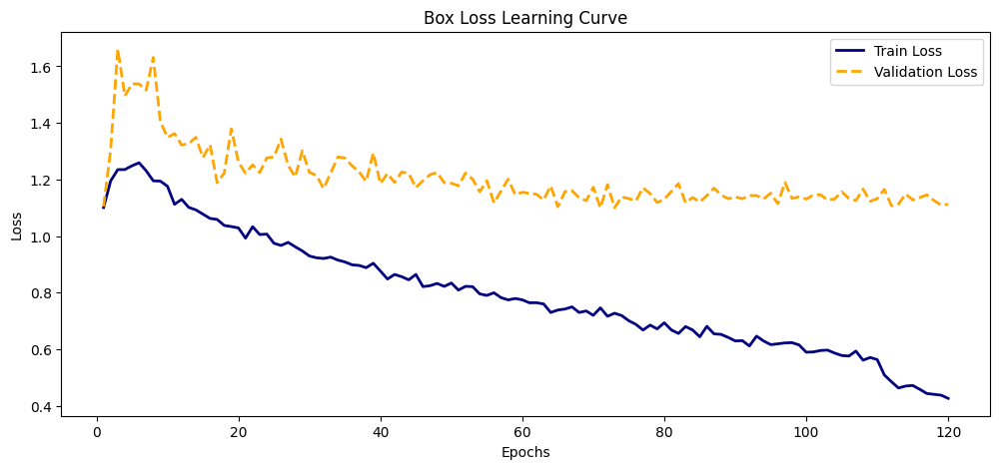

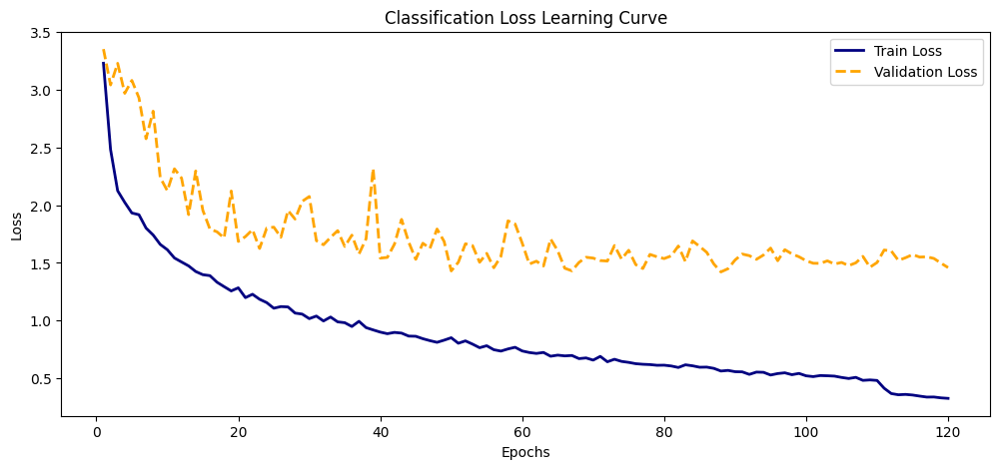

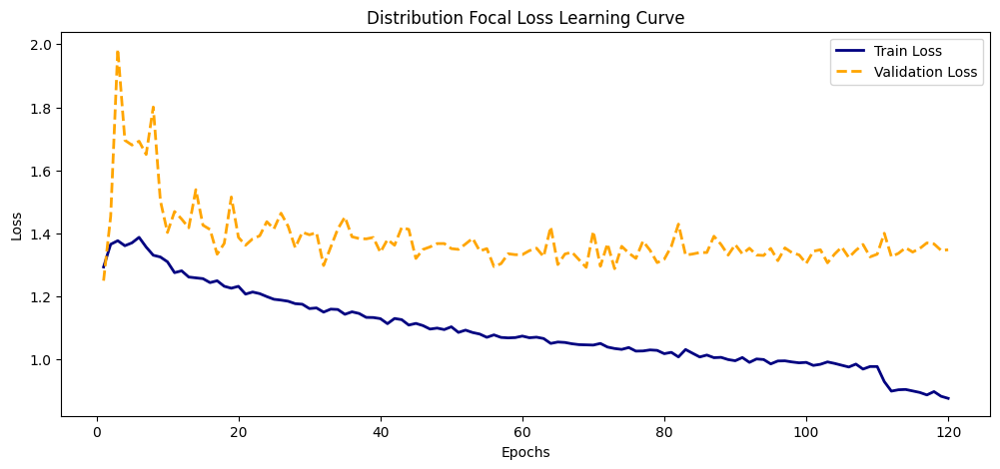

In [16]:
# Create the full file path for 'results.csv' using the directory path and file name
results_csv_path = os.path.join(post_training_files_path, 'results.csv')

# Load the CSV file from the constructed path into a pandas DataFrame
df = pd.read_csv(results_csv_path)

# Remove any leading whitespace from the column names
df.columns = df.columns.str.strip()

# Plot the learning curves for each loss
plot_learning_curve(df, 'train/box_loss', 'val/box_loss', 'Box Loss Learning Curve')
plot_learning_curve(df, 'train/cls_loss', 'val/cls_loss', 'Classification Loss Learning Curve')
plot_learning_curve(df, 'train/dfl_loss', 'val/dfl_loss', 'Distribution Focal Loss Learning Curve')

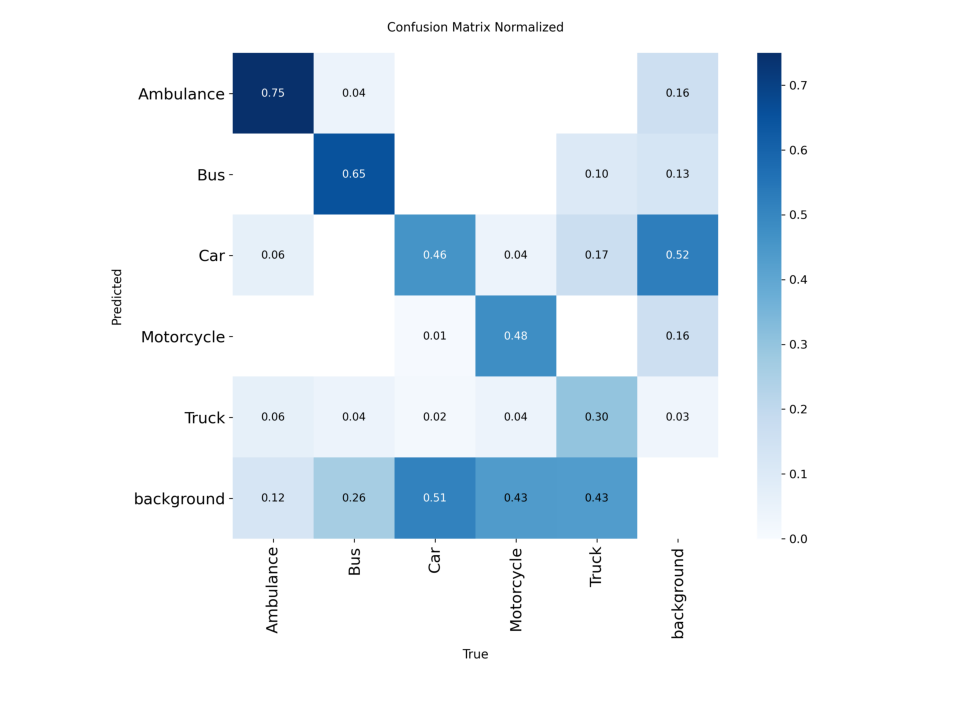

In [17]:
# Construct the path to the normalized confusion matrix image
confusion_matrix_path = os.path.join(post_training_files_path, 'confusion_matrix_normalized.png')

# Read the image using cv2
cm_img = cv2.imread(confusion_matrix_path)

# Convert the image from BGR to RGB color space for accurate color representation with matplotlib
cm_img = cv2.cvtColor(cm_img, cv2.COLOR_BGR2RGB)

# Display the image
plt.figure(figsize=(10, 10), dpi=120)
plt.imshow(cm_img)
plt.axis('off')
plt.show()



 <p style="color:black;font-family:newtimeroman;font-size:250%;text-align:center; font-weight:8000">🟡 YOLO 11 RESULTS ,BUILD FROM SCRATCH 🟡 </p>

In [18]:
# Construct the path to the best model weights file using os.path.join
best_model_path_yolo_detect = os.path.join(post_training_files_path, 'weights/best.pt')

# Load the best model weights into the YOLO model
best_model_yolo_detect = YOLO(best_model_path_yolo_detect)

# Validate the best model using the validation set with default parameters
metrics_yolo_detect = best_model_yolo_detect.val(split='val')

Ultralytics 8.3.167 🚀 Python-3.11.13 torch-2.6.0+cu124 CUDA:0 (Tesla T4, 15095MiB)
YOLO11n summary (fused): 100 layers, 2,583,127 parameters, 0 gradients, 6.3 GFLOPs
val: Fast image access ✅ (ping: 0.4±0.2 ms, read: 83.9±28.3 MB/s, size: 31.0 KB)


val: Scanning /kaggle/input/vehicledetection/VehiclesDetectionDataset/valid/labels... 250 images, 0 backgrounds, 0 corrupt: 100%|██████████| 250/250 [00:00<00:00, 521.79it/s]

WARNING ⚠️ val: Cache directory /kaggle/input/vehicledetection/VehiclesDetectionDataset/valid is not writeable, cache not saved.



                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 16/16 [00:02<00:00,  5.87it/s]


                   all        250        454      0.691      0.515       0.59      0.455
             Ambulance         50         64      0.799       0.75      0.855      0.779
                   Bus         30         46      0.754      0.667      0.724      0.584
                   Car         90        238      0.708      0.412      0.486      0.333
            Motorcycle         42         46      0.671      0.478      0.543       0.33
                 Truck         38         60      0.522      0.267      0.343      0.248
Speed: 1.1ms preprocess, 3.0ms inference, 0.0ms loss, 1.3ms postprocess per image
Results saved to runs/detect/val


 <p style="color:black;font-family:newtimeroman;font-size:250%;text-align:center; font-weight:8000">🟡 AS you can clearly see,results from building a model with low number of samples with yolo from scratch is not accebtable,so lets use Transfer Learning 🟡 </p>

# <p style="padding:20px;background-color:black;margin:0;color:yellow;font-family:newtimeroman;font-size:120%;text-align:center;border-radius: 15px 500px;overflow:hidden;font-weight:800">🌕 Step 6  | YOLO11 Transfer Learning </p>

![SSD Performance Evaluation — Mozilla Firefox 2_17_2025 5_35_02 PM.png](attachment:40dae3e5-3620-447c-9404-e3686712d09b.png)

In [19]:
model = YOLO("yolo11s.pt")

In [20]:
# Train the model on our custom dataset
results = model.train(
    data=yaml_file_path,     # Path to the dataset configuration file
    epochs=120,              # Number of epochs to train for
    imgsz=416,               # Size of input images as integer
    device=0,                # Device to run on, i.e. cuda device=0
    patience=150,             # Epochs to wait for no observable improvement for early stopping of training
    batch=8,                # Number of images per batch
    optimizer='auto',        # Optimizer to use, choices=[SGD, Adam, Adamax, AdamW, NAdam, RAdam, RMSProp, auto]
    lr0=0.0001,              # Initial learning rate
    lrf=0.1,                 # Final learning rate (lr0 * lrf)
    dropout=0.3,             # Automatically restore best model# Use dropout regularization
    freeze=15,               # lets freeze the first 15 layers to use its original weight
    seed=0                   # Random seed for reproducibility
)

Ultralytics 8.3.167 🚀 Python-3.11.13 torch-2.6.0+cu124 CUDA:0 (Tesla T4, 15095MiB)
engine/trainer: agnostic_nms=False, amp=True, augment=False, auto_augment=randaugment, batch=8, bgr=0.0, box=7.5, cache=False, cfg=None, classes=None, close_mosaic=10, cls=0.5, conf=None, copy_paste=0.0, copy_paste_mode=flip, cos_lr=False, cutmix=0.0, data=/kaggle/input/vehicledetection/VehiclesDetectionDataset/dataset.yaml, degrees=0.0, deterministic=True, device=0, dfl=1.5, dnn=False, dropout=0.3, dynamic=False, embed=None, epochs=120, erasing=0.4, exist_ok=False, fliplr=0.5, flipud=0.0, format=torchscript, fraction=1.0, freeze=15, half=False, hsv_h=0.015, hsv_s=0.7, hsv_v=0.4, imgsz=416, int8=False, iou=0.7, keras=False, kobj=1.0, line_width=None, lr0=0.0001, lrf=0.1, mask_ratio=4, max_det=300, mixup=0.0, mode=train, model=yolo11s.pt, momentum=0.937, mosaic=1.0, multi_scale=False, name=train2, nbs=64, nms=False, opset=None, optimize=False, optimizer=auto, overlap_mask=True, patience=150, perspective=0

train: Scanning /kaggle/input/vehicledetection/VehiclesDetectionDataset/train/labels... 878 images, 0 backgrounds, 0 corrupt: 100%|██████████| 878/878 [00:01<00:00, 510.28it/s]

WARNING ⚠️ train: Cache directory /kaggle/input/vehicledetection/VehiclesDetectionDataset/train is not writeable, cache not saved.
albumentations: Blur(p=0.01, blur_limit=(3, 7)), MedianBlur(p=0.01, blur_limit=(3, 7)), ToGray(p=0.01, method='weighted_average', num_output_channels=3), CLAHE(p=0.01, clip_limit=(1.0, 4.0), tile_grid_size=(8, 8))


val: Fast image access ✅ (ping: 0.0±0.0 ms, read: 70.1±17.1 MB/s, size: 33.0 KB)


val: Scanning /kaggle/input/vehicledetection/VehiclesDetectionDataset/valid/labels... 250 images, 0 backgrounds, 0 corrupt: 100%|██████████| 250/250 [00:00<00:00, 485.36it/s]

WARNING ⚠️ val: Cache directory /kaggle/input/vehicledetection/VehiclesDetectionDataset/valid is not writeable, cache not saved.


Plotting labels to runs/detect/train2/labels.jpg... 
optimizer: 'optimizer=auto' found, ignoring 'lr0=0.0001' and 'momentum=0.937' and determining best 'optimizer', 'lr0' and 'momentum' automatically... 
optimizer: AdamW(lr=0.001111, momentum=0.9) with parameter groups 81 weight(decay=0.0), 88 weight(decay=0.0005), 87 bias(decay=0.0)
Image sizes 416 train, 416 val
Using 2 dataloader workers
Logging results to runs/detect/train2
Starting training for 120 epochs...

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      1/120     0.605G      1.051      1.809      1.252         28        416: 100%|██████████| 110/110 [00:13<00:00,  8.39it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 16/16 [00:02<00:00,  7.94it/s]


                   all        250        454      0.514      0.596        0.6      0.454

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      2/120      0.68G      1.143      1.477      1.299         25        416: 100%|██████████| 110/110 [00:12<00:00,  8.61it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 16/16 [00:01<00:00,  9.58it/s]


                   all        250        454      0.715       0.59       0.69      0.503

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      3/120     0.752G      1.157      1.351      1.284         24        416: 100%|██████████| 110/110 [00:11<00:00,  9.48it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 16/16 [00:01<00:00,  9.80it/s]


                   all        250        454      0.766      0.503       0.61       0.44

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      4/120     0.775G      1.144      1.358      1.277         17        416: 100%|██████████| 110/110 [00:11<00:00,  9.60it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 16/16 [00:01<00:00, 10.10it/s]


                   all        250        454      0.644      0.626      0.673      0.512

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      5/120     0.793G      1.138      1.294      1.252         16        416: 100%|██████████| 110/110 [00:11<00:00,  9.66it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 16/16 [00:01<00:00,  9.84it/s]

                   all        250        454      0.623      0.671      0.656      0.464



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      6/120     0.824G      1.082       1.25      1.244         17        416: 100%|██████████| 110/110 [00:11<00:00,  9.79it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 16/16 [00:01<00:00,  9.79it/s]

                   all        250        454      0.643      0.597      0.682      0.504



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      7/120     0.898G      1.068      1.183      1.229         24        416: 100%|██████████| 110/110 [00:11<00:00,  9.60it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 16/16 [00:01<00:00,  9.94it/s]

                   all        250        454      0.657      0.655      0.653      0.493



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      8/120     0.922G      1.031      1.161      1.206         11        416: 100%|██████████| 110/110 [00:11<00:00,  9.68it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 16/16 [00:01<00:00,  9.81it/s]

                   all        250        454      0.723      0.632      0.695      0.532



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      9/120     0.939G       1.04      1.143      1.218         21        416: 100%|██████████| 110/110 [00:11<00:00,  9.64it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 16/16 [00:01<00:00, 10.27it/s]

                   all        250        454      0.691       0.61      0.629      0.469



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     10/120     0.971G      1.023      1.113       1.21         20        416: 100%|██████████| 110/110 [00:11<00:00,  9.79it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 16/16 [00:01<00:00, 10.09it/s]

                   all        250        454      0.652      0.593      0.649      0.477



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     11/120     0.996G     0.9882      1.084      1.194         13        416: 100%|██████████| 110/110 [00:11<00:00,  9.58it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 16/16 [00:01<00:00, 10.05it/s]

                   all        250        454      0.637      0.658      0.651      0.488



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     12/120      1.02G      1.011      1.112      1.203         26        416: 100%|██████████| 110/110 [00:11<00:00,  9.75it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 16/16 [00:01<00:00, 10.02it/s]

                   all        250        454      0.696      0.625      0.661      0.502



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     13/120      1.04G     0.9884      1.067      1.182         36        416: 100%|██████████| 110/110 [00:11<00:00,  9.65it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 16/16 [00:01<00:00,  9.97it/s]


                   all        250        454      0.676       0.57      0.646       0.49

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     14/120      1.12G     0.9444       1.01      1.165         21        416: 100%|██████████| 110/110 [00:11<00:00,  9.71it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 16/16 [00:01<00:00, 10.01it/s]

                   all        250        454      0.716      0.626      0.651      0.499



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     15/120      1.14G     0.9531       1.02       1.17         30        416: 100%|██████████| 110/110 [00:11<00:00,  9.70it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 16/16 [00:01<00:00,  8.85it/s]

                   all        250        454      0.708      0.605      0.672      0.503



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     16/120      1.17G     0.9482     0.9911      1.161         17        416: 100%|██████████| 110/110 [00:11<00:00,  9.96it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 16/16 [00:02<00:00,  7.86it/s]

                   all        250        454      0.696      0.689      0.703      0.532



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     17/120      1.19G     0.9342     0.9693      1.155         29        416: 100%|██████████| 110/110 [00:10<00:00, 10.33it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 16/16 [00:02<00:00,  6.85it/s]

                   all        250        454      0.639      0.637      0.652      0.475



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     18/120      1.22G     0.9544     0.9927      1.163         29        416: 100%|██████████| 110/110 [00:10<00:00, 10.48it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 16/16 [00:02<00:00,  6.68it/s]

                   all        250        454       0.71      0.669      0.709      0.509



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     19/120      1.24G     0.9263     0.9298      1.136         29        416: 100%|██████████| 110/110 [00:10<00:00, 10.18it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 16/16 [00:02<00:00,  7.29it/s]

                   all        250        454      0.696      0.594      0.686      0.517



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     20/120      1.31G     0.8885     0.9179      1.135         20        416: 100%|██████████| 110/110 [00:11<00:00,  9.67it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 16/16 [00:01<00:00,  8.97it/s]

                   all        250        454      0.761      0.589       0.67      0.508



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     21/120      1.33G     0.8731     0.8829       1.12         27        416: 100%|██████████| 110/110 [00:11<00:00,  9.60it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 16/16 [00:01<00:00,  9.79it/s]

                   all        250        454      0.699      0.676      0.704      0.524



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     22/120      1.36G       0.91     0.9257      1.137         12        416: 100%|██████████| 110/110 [00:11<00:00,  9.51it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 16/16 [00:01<00:00,  9.84it/s]

                   all        250        454      0.643      0.738      0.695      0.527



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     23/120      1.39G     0.8654     0.8864       1.11         29        416: 100%|██████████| 110/110 [00:11<00:00,  9.53it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 16/16 [00:01<00:00,  9.77it/s]


                   all        250        454      0.619      0.725      0.697      0.532

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     24/120      1.41G     0.8804     0.8853      1.128         21        416: 100%|██████████| 110/110 [00:11<00:00,  9.43it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 16/16 [00:01<00:00,  9.68it/s]

                   all        250        454      0.723      0.612        0.7      0.535



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     25/120      1.48G     0.8417     0.8552      1.103         44        416: 100%|██████████| 110/110 [00:11<00:00,  9.41it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 16/16 [00:01<00:00,  9.30it/s]

                   all        250        454      0.638       0.68      0.707      0.537



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     26/120      1.51G     0.8381       0.84      1.106         29        416: 100%|██████████| 110/110 [00:12<00:00,  9.03it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 16/16 [00:01<00:00,  9.79it/s]


                   all        250        454      0.684      0.594      0.671      0.513

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     27/120      1.53G     0.8319     0.8289      1.096         19        416: 100%|██████████| 110/110 [00:11<00:00,  9.22it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 16/16 [00:01<00:00,  9.51it/s]

                   all        250        454      0.693      0.626      0.686      0.534



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     28/120      1.56G     0.8174       0.81      1.094         21        416: 100%|██████████| 110/110 [00:11<00:00,  9.31it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 16/16 [00:01<00:00,  9.60it/s]

                   all        250        454      0.618      0.675       0.68      0.502



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     29/120      1.57G     0.8326     0.8142       1.09         26        416: 100%|██████████| 110/110 [00:11<00:00,  9.30it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 16/16 [00:01<00:00,  9.84it/s]

                   all        250        454      0.681      0.664      0.681      0.512



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     30/120      1.61G     0.8319     0.8091        1.1         22        416: 100%|██████████| 110/110 [00:11<00:00,  9.43it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 16/16 [00:01<00:00,  9.90it/s]

                   all        250        454      0.688      0.657      0.689      0.527



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     31/120      1.63G     0.8139     0.8165      1.091         20        416: 100%|██████████| 110/110 [00:11<00:00,  9.36it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 16/16 [00:01<00:00,  9.77it/s]

                   all        250        454      0.704      0.634      0.675      0.501



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     32/120      1.65G      0.814     0.7777      1.096         25        416: 100%|██████████| 110/110 [00:11<00:00,  9.49it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 16/16 [00:01<00:00,  8.53it/s]

                   all        250        454      0.702      0.619      0.666      0.504



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     33/120      1.72G     0.7979     0.7647      1.082         25        416: 100%|██████████| 110/110 [00:11<00:00,  9.72it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 16/16 [00:02<00:00,  6.99it/s]

                   all        250        454      0.591      0.689      0.667      0.505



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     34/120      1.75G     0.8015     0.7386      1.081         11        416: 100%|██████████| 110/110 [00:10<00:00, 10.13it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 16/16 [00:02<00:00,  6.52it/s]


                   all        250        454      0.632      0.701      0.694      0.518

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     35/120      1.78G     0.7964     0.7582      1.088         16        416: 100%|██████████| 110/110 [00:11<00:00,  9.84it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 16/16 [00:02<00:00,  7.85it/s]


                   all        250        454      0.697      0.688      0.706      0.532

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     36/120       1.8G     0.7884       0.75      1.071         14        416: 100%|██████████| 110/110 [00:11<00:00,  9.35it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 16/16 [00:01<00:00,  9.80it/s]

                   all        250        454      0.646      0.712      0.682      0.512



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     37/120      1.82G     0.7929     0.7728      1.079         27        416: 100%|██████████| 110/110 [00:11<00:00,  9.37it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 16/16 [00:01<00:00,  9.93it/s]

                   all        250        454      0.619       0.66      0.669      0.502



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     38/120      1.85G     0.7893     0.7563      1.072         25        416: 100%|██████████| 110/110 [00:11<00:00,  9.26it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 16/16 [00:01<00:00,  9.76it/s]

                   all        250        454      0.655      0.675      0.671       0.51



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     39/120      1.92G     0.7921     0.7484      1.078         25        416: 100%|██████████| 110/110 [00:11<00:00,  9.20it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 16/16 [00:01<00:00,  9.54it/s]


                   all        250        454      0.701      0.649      0.684      0.519

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     40/120      1.95G     0.7596     0.7179       1.06         18        416: 100%|██████████| 110/110 [00:11<00:00,  9.45it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 16/16 [00:01<00:00, 10.06it/s]

                   all        250        454      0.733      0.694      0.719      0.541



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     41/120      1.96G     0.7854     0.7559      1.075         10        416: 100%|██████████| 110/110 [00:11<00:00,  9.53it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 16/16 [00:01<00:00, 10.04it/s]

                   all        250        454      0.669      0.721      0.694      0.528



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     42/120         2G     0.7923     0.7387      1.078         12        416: 100%|██████████| 110/110 [00:11<00:00,  9.56it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 16/16 [00:01<00:00, 10.06it/s]

                   all        250        454      0.639      0.723      0.693      0.524



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     43/120      2.02G     0.7488      0.707      1.058         18        416: 100%|██████████| 110/110 [00:11<00:00,  9.56it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 16/16 [00:01<00:00, 10.06it/s]


                   all        250        454      0.648      0.674      0.682      0.523

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     44/120      2.05G     0.7548     0.6983      1.056         34        416: 100%|██████████| 110/110 [00:11<00:00,  9.37it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 16/16 [00:01<00:00,  9.86it/s]


                   all        250        454      0.735      0.645        0.7      0.534

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     45/120      2.11G     0.7706     0.6999      1.062         16        416: 100%|██████████| 110/110 [00:12<00:00,  9.09it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 16/16 [00:01<00:00,  9.68it/s]

                   all        250        454      0.622      0.677      0.699      0.537



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     46/120      2.14G     0.7598      0.719      1.045         27        416: 100%|██████████| 110/110 [00:11<00:00,  9.38it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 16/16 [00:01<00:00,  9.39it/s]

                   all        250        454      0.668      0.686      0.704      0.518



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     47/120      2.17G     0.7348     0.6874      1.044         22        416: 100%|██████████| 110/110 [00:11<00:00,  9.21it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 16/16 [00:01<00:00,  8.44it/s]

                   all        250        454      0.693      0.661      0.718       0.54



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     48/120      2.19G     0.7192     0.6733      1.039         19        416: 100%|██████████| 110/110 [00:11<00:00,  9.76it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 16/16 [00:02<00:00,  7.16it/s]

                   all        250        454      0.635      0.714       0.72      0.549



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     49/120      2.21G     0.7455     0.6947      1.057         17        416: 100%|██████████| 110/110 [00:11<00:00,  9.96it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 16/16 [00:02<00:00,  6.81it/s]

                   all        250        454      0.705      0.631        0.7      0.528



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     50/120      2.24G      0.711     0.6618      1.031         20        416: 100%|██████████| 110/110 [00:10<00:00, 10.16it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 16/16 [00:02<00:00,  7.39it/s]


                   all        250        454      0.671      0.706      0.704      0.525

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     51/120      2.26G     0.7193     0.6805      1.052         21        416: 100%|██████████| 110/110 [00:11<00:00,  9.31it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 16/16 [00:01<00:00,  9.42it/s]

                   all        250        454      0.636        0.7      0.693      0.518



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     52/120      2.29G     0.7377     0.6641      1.039         35        416: 100%|██████████| 110/110 [00:11<00:00,  9.43it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 16/16 [00:01<00:00,  9.75it/s]

                   all        250        454      0.629      0.651      0.679      0.493



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     53/120      2.36G     0.7015     0.6469      1.029         26        416: 100%|██████████| 110/110 [00:11<00:00,  9.33it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 16/16 [00:01<00:00,  9.65it/s]

                   all        250        454      0.637      0.657      0.675      0.527



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     54/120      2.39G     0.6841     0.6364      1.019         17        416: 100%|██████████| 110/110 [00:11<00:00,  9.35it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 16/16 [00:01<00:00,  9.86it/s]

                   all        250        454      0.718      0.594      0.684      0.515



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     55/120      2.41G     0.7093     0.6539      1.033         26        416: 100%|██████████| 110/110 [00:11<00:00,  9.38it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 16/16 [00:01<00:00,  9.99it/s]

                   all        250        454      0.713      0.644       0.69      0.519



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     56/120      2.48G     0.7089     0.6375      1.033         20        416: 100%|██████████| 110/110 [00:11<00:00,  9.28it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 16/16 [00:01<00:00,  9.83it/s]

                   all        250        454      0.673      0.666      0.695      0.532



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     57/120       2.5G     0.6647     0.5967      1.012         29        416: 100%|██████████| 110/110 [00:11<00:00,  9.34it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 16/16 [00:01<00:00,  9.40it/s]

                   all        250        454      0.695       0.66      0.697      0.531



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     58/120      2.53G     0.7137     0.6443      1.028         16        416: 100%|██████████| 110/110 [00:11<00:00,  9.38it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 16/16 [00:01<00:00,  9.83it/s]

                   all        250        454      0.718      0.612      0.675      0.526



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     59/120      2.56G     0.6861     0.6313      1.021         21        416: 100%|██████████| 110/110 [00:11<00:00,  9.29it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 16/16 [00:01<00:00,  9.69it/s]

                   all        250        454      0.701      0.595      0.661      0.511



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     60/120      2.58G     0.6726     0.6157       1.02         22        416: 100%|██████████| 110/110 [00:11<00:00,  9.25it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 16/16 [00:01<00:00,  9.84it/s]

                   all        250        454       0.67      0.679      0.672       0.51



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     61/120       2.6G     0.7017     0.6297      1.035         31        416: 100%|██████████| 110/110 [00:11<00:00,  9.38it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 16/16 [00:01<00:00,  9.88it/s]

                   all        250        454      0.729      0.633      0.705      0.517



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     62/120      2.63G     0.6985     0.6231      1.035         34        416: 100%|██████████| 110/110 [00:11<00:00,  9.36it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 16/16 [00:01<00:00,  8.44it/s]

                   all        250        454      0.744      0.617      0.659      0.497



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     63/120      2.65G      0.669     0.6026      1.013         23        416: 100%|██████████| 110/110 [00:11<00:00, 10.00it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 16/16 [00:02<00:00,  7.83it/s]

                   all        250        454      0.681      0.661      0.689      0.517



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     64/120      2.73G     0.6656     0.6005      1.011         36        416: 100%|██████████| 110/110 [00:10<00:00, 10.20it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 16/16 [00:02<00:00,  6.65it/s]

                   all        250        454      0.762        0.6      0.689      0.527



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     65/120      2.75G     0.6605     0.5956      1.011         22        416: 100%|██████████| 110/110 [00:10<00:00, 10.18it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 16/16 [00:02<00:00,  7.11it/s]

                   all        250        454      0.705      0.655      0.689      0.522



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     66/120      2.78G     0.6518     0.5822      1.007         29        416: 100%|██████████| 110/110 [00:11<00:00,  9.76it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 16/16 [00:01<00:00,  8.31it/s]

                   all        250        454      0.706      0.642      0.673       0.51



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     67/120       2.8G     0.6578     0.6028      1.006         24        416: 100%|██████████| 110/110 [00:11<00:00,  9.50it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 16/16 [00:01<00:00, 10.00it/s]

                   all        250        454      0.727      0.641      0.691      0.526



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     68/120      2.83G     0.6721     0.5874      1.011         33        416: 100%|██████████| 110/110 [00:11<00:00,  9.47it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 16/16 [00:01<00:00,  9.95it/s]

                   all        250        454      0.764      0.607      0.687      0.516



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     69/120      2.84G     0.6613     0.5972      1.009         17        416: 100%|██████████| 110/110 [00:11<00:00,  9.40it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 16/16 [00:01<00:00, 10.02it/s]

                   all        250        454      0.735      0.654      0.694      0.535



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     70/120      2.88G     0.6592     0.5774      1.012         18        416: 100%|██████████| 110/110 [00:11<00:00,  9.50it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 16/16 [00:01<00:00, 10.02it/s]

                   all        250        454      0.715      0.655      0.694      0.528



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     71/120       2.9G     0.6671     0.5863      1.015         17        416: 100%|██████████| 110/110 [00:11<00:00,  9.33it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 16/16 [00:01<00:00,  9.96it/s]

                   all        250        454      0.661       0.66      0.677      0.517



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     72/120      2.92G     0.6523     0.5835      1.012         19        416: 100%|██████████| 110/110 [00:11<00:00,  9.19it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 16/16 [00:01<00:00, 10.06it/s]

                   all        250        454      0.672       0.68      0.684      0.508



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     73/120      2.99G     0.6503     0.5755      1.004         13        416: 100%|██████████| 110/110 [00:12<00:00,  9.12it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 16/16 [00:01<00:00,  9.68it/s]

                   all        250        454      0.648      0.682      0.676       0.51



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     74/120      3.02G     0.6248     0.5784     0.9953         21        416: 100%|██████████| 110/110 [00:11<00:00,  9.32it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 16/16 [00:01<00:00,  9.90it/s]

                   all        250        454      0.651      0.676      0.663      0.496



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     75/120      3.05G     0.6304     0.5533     0.9973         22        416: 100%|██████████| 110/110 [00:11<00:00,  9.36it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 16/16 [00:01<00:00,  9.78it/s]

                   all        250        454      0.689      0.681      0.678        0.5



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     76/120      3.07G     0.6214     0.5552     0.9992         26        416: 100%|██████████| 110/110 [00:11<00:00,  9.37it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 16/16 [00:01<00:00,  9.80it/s]

                   all        250        454      0.737      0.587      0.675      0.507



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     77/120      3.14G     0.6292     0.5591     0.9934         27        416: 100%|██████████| 110/110 [00:11<00:00,  9.17it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 16/16 [00:01<00:00,  9.33it/s]


                   all        250        454      0.682      0.642      0.679      0.511

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     78/120      3.17G     0.6262      0.561     0.9951         21        416: 100%|██████████| 110/110 [00:12<00:00,  9.16it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 16/16 [00:02<00:00,  7.67it/s]

                   all        250        454      0.601      0.663      0.679      0.517



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     79/120      3.19G     0.6195     0.5461     0.9907         21        416: 100%|██████████| 110/110 [00:11<00:00,  9.93it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 16/16 [00:02<00:00,  6.61it/s]

                   all        250        454      0.668      0.665      0.689      0.522



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     80/120      3.22G     0.6326     0.5577     0.9985         22        416: 100%|██████████| 110/110 [00:11<00:00,  9.92it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 16/16 [00:02<00:00,  7.10it/s]


                   all        250        454      0.686      0.648      0.681      0.516

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     81/120      3.24G     0.6168     0.5451     0.9897         31        416: 100%|██████████| 110/110 [00:11<00:00,  9.47it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 16/16 [00:01<00:00,  8.97it/s]

                   all        250        454      0.683      0.639      0.666      0.503



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     82/120      3.27G     0.6246     0.5458     0.9943         23        416: 100%|██████████| 110/110 [00:11<00:00,  9.18it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 16/16 [00:01<00:00,  9.87it/s]

                   all        250        454      0.631      0.698      0.663      0.497



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     83/120      3.29G     0.6151     0.5562     0.9843         24        416: 100%|██████████| 110/110 [00:11<00:00,  9.40it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 16/16 [00:01<00:00, 10.00it/s]

                   all        250        454      0.651      0.681      0.683      0.516



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     84/120      3.31G     0.6148     0.5376     0.9871         18        416: 100%|██████████| 110/110 [00:11<00:00,  9.23it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 16/16 [00:01<00:00, 10.20it/s]

                   all        250        454      0.689      0.635      0.675      0.505



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     85/120      3.38G     0.5985     0.5353     0.9865         10        416: 100%|██████████| 110/110 [00:11<00:00,  9.39it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 16/16 [00:01<00:00,  9.90it/s]

                   all        250        454      0.742      0.588      0.666      0.508



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     86/120      3.41G     0.5905     0.5269     0.9829         26        416: 100%|██████████| 110/110 [00:11<00:00,  9.32it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 16/16 [00:01<00:00,  9.90it/s]

                   all        250        454      0.627      0.684      0.666      0.511



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     87/120      3.44G      0.603      0.533     0.9875         29        416: 100%|██████████| 110/110 [00:12<00:00,  9.08it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 16/16 [00:01<00:00,  9.94it/s]

                   all        250        454      0.626      0.668      0.675      0.516



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     88/120      3.46G      0.597     0.5227     0.9788         24        416: 100%|██████████| 110/110 [00:11<00:00,  9.32it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 16/16 [00:01<00:00, 10.06it/s]

                   all        250        454      0.632      0.707      0.673      0.511



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     89/120      3.48G     0.5955     0.5186     0.9844         16        416: 100%|██████████| 110/110 [00:12<00:00,  9.16it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 16/16 [00:01<00:00,  9.61it/s]

                   all        250        454      0.698      0.654       0.67      0.506



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     90/120      3.51G     0.6006     0.5159     0.9839         20        416: 100%|██████████| 110/110 [00:12<00:00,  9.14it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 16/16 [00:01<00:00,  9.33it/s]

                   all        250        454      0.692      0.634      0.679      0.516



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     91/120      3.58G      0.594     0.5189     0.9907         17        416: 100%|██████████| 110/110 [00:11<00:00,  9.26it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 16/16 [00:01<00:00,  9.91it/s]

                   all        250        454      0.657      0.677      0.683      0.524



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     92/120      3.61G     0.5844     0.5051      0.975         31        416: 100%|██████████| 110/110 [00:11<00:00,  9.57it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 16/16 [00:01<00:00, 10.02it/s]

                   all        250        454      0.706       0.64      0.689      0.527



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     93/120      3.62G     0.5949      0.513     0.9773         21        416: 100%|██████████| 110/110 [00:11<00:00,  9.29it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 16/16 [00:02<00:00,  7.26it/s]

                   all        250        454      0.736      0.611      0.674      0.517



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     94/120      3.66G     0.5864     0.5042      0.979         32        416: 100%|██████████| 110/110 [00:11<00:00,  9.80it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 16/16 [00:02<00:00,  6.82it/s]

                   all        250        454      0.731      0.614      0.666        0.5



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     95/120      3.68G     0.5937     0.5162      0.975         22        416: 100%|██████████| 110/110 [00:11<00:00,  9.67it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 16/16 [00:01<00:00,  8.14it/s]

                   all        250        454      0.718      0.658      0.683      0.522



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     96/120      3.75G     0.5766     0.4931     0.9771         28        416: 100%|██████████| 110/110 [00:11<00:00,  9.41it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 16/16 [00:01<00:00,  9.80it/s]

                   all        250        454       0.71      0.626      0.669       0.51



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     97/120      3.77G     0.5615     0.4891     0.9688         27        416: 100%|██████████| 110/110 [00:11<00:00,  9.28it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 16/16 [00:01<00:00,  9.64it/s]


                   all        250        454       0.66      0.673      0.672      0.514

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     98/120       3.8G     0.5808     0.5093     0.9796         22        416: 100%|██████████| 110/110 [00:11<00:00,  9.45it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 16/16 [00:01<00:00, 10.16it/s]

                   all        250        454       0.66      0.685      0.689      0.517



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     99/120      3.83G     0.5729     0.4921     0.9701         14        416: 100%|██████████| 110/110 [00:11<00:00,  9.36it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 16/16 [00:01<00:00, 10.28it/s]

                   all        250        454      0.653      0.665      0.666      0.507



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    100/120      3.85G     0.5794     0.4881     0.9726         24        416: 100%|██████████| 110/110 [00:11<00:00,  9.59it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 16/16 [00:01<00:00, 10.09it/s]

                   all        250        454       0.68      0.635      0.669      0.509



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    101/120      3.87G     0.5514      0.478      0.972         19        416: 100%|██████████| 110/110 [00:11<00:00,  9.48it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 16/16 [00:01<00:00,  9.47it/s]

                   all        250        454      0.653      0.656       0.67      0.511



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    102/120       3.9G     0.5944     0.5081     0.9788         19        416: 100%|██████████| 110/110 [00:11<00:00,  9.45it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 16/16 [00:01<00:00, 10.20it/s]

                   all        250        454      0.722      0.633      0.669      0.512



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    103/120      3.92G     0.5613     0.4807     0.9642         19        416: 100%|██████████| 110/110 [00:11<00:00,  9.40it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 16/16 [00:01<00:00,  9.91it/s]

                   all        250        454       0.69      0.641      0.681      0.515



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    104/120         4G     0.5764     0.5046     0.9721         27        416: 100%|██████████| 110/110 [00:11<00:00,  9.28it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 16/16 [00:01<00:00,  9.93it/s]


                   all        250        454      0.635      0.708       0.68      0.511

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    105/120      4.01G     0.5569     0.4802     0.9675         24        416: 100%|██████████| 110/110 [00:11<00:00,  9.44it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 16/16 [00:01<00:00, 10.16it/s]

                   all        250        454      0.762       0.64      0.694      0.521



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    106/120      4.04G     0.5513     0.4645     0.9616         12        416: 100%|██████████| 110/110 [00:11<00:00,  9.33it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 16/16 [00:01<00:00, 10.01it/s]

                   all        250        454      0.671        0.7      0.679      0.514



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    107/120      4.07G     0.5433     0.4641     0.9603         12        416: 100%|██████████| 110/110 [00:11<00:00,  9.40it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 16/16 [00:01<00:00, 10.09it/s]

                   all        250        454      0.631      0.721      0.675      0.512



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    108/120       4.1G     0.5592      0.478     0.9673         27        416: 100%|██████████| 110/110 [00:11<00:00,  9.30it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 16/16 [00:01<00:00,  8.66it/s]

                   all        250        454      0.675      0.695      0.669      0.511



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    109/120      4.11G     0.5568     0.4809     0.9677         23        416: 100%|██████████| 110/110 [00:11<00:00,  9.75it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 16/16 [00:02<00:00,  7.16it/s]

                   all        250        454      0.736       0.62      0.685      0.515



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    110/120      4.14G     0.5531     0.4847     0.9643         20        416: 100%|██████████| 110/110 [00:10<00:00, 10.06it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 16/16 [00:02<00:00,  6.80it/s]


                   all        250        454      0.699      0.638       0.68      0.518
Closing dataloader mosaic
albumentations: Blur(p=0.01, blur_limit=(3, 7)), MedianBlur(p=0.01, blur_limit=(3, 7)), ToGray(p=0.01, method='weighted_average', num_output_channels=3), CLAHE(p=0.01, clip_limit=(1.0, 4.0), tile_grid_size=(8, 8))

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    111/120      4.22G     0.4529     0.3519     0.9008         14        416: 100%|██████████| 110/110 [00:11<00:00,  9.26it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 16/16 [00:01<00:00,  9.22it/s]

                   all        250        454      0.754      0.624       0.68      0.521



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    112/120      4.24G     0.4464     0.3324     0.8916         12        416: 100%|██████████| 110/110 [00:11<00:00,  9.75it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 16/16 [00:01<00:00,  9.61it/s]


                   all        250        454      0.666      0.659      0.675      0.525

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    113/120      4.26G     0.4387      0.317     0.8889          9        416: 100%|██████████| 110/110 [00:11<00:00,  9.89it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 16/16 [00:01<00:00,  9.83it/s]

                   all        250        454      0.714      0.645      0.689      0.528



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    114/120      4.29G     0.4421     0.3281      0.892         12        416: 100%|██████████| 110/110 [00:11<00:00,  9.76it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 16/16 [00:01<00:00, 10.15it/s]

                   all        250        454      0.734      0.617      0.688      0.524



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    115/120      4.36G     0.4328     0.3216     0.8956         16        416: 100%|██████████| 110/110 [00:11<00:00,  9.58it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 16/16 [00:01<00:00,  9.88it/s]

                   all        250        454      0.755       0.62      0.685      0.525



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    116/120      4.39G      0.423     0.3113      0.896         14        416: 100%|██████████| 110/110 [00:11<00:00,  9.65it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 16/16 [00:01<00:00,  9.90it/s]

                   all        250        454      0.674      0.674      0.681      0.524



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    117/120       4.4G     0.4286     0.3169     0.8949         10        416: 100%|██████████| 110/110 [00:11<00:00,  9.62it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 16/16 [00:01<00:00, 10.05it/s]

                   all        250        454      0.732      0.625      0.678      0.525



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    118/120      4.44G     0.4303     0.3149     0.8873         14        416: 100%|██████████| 110/110 [00:11<00:00,  9.84it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 16/16 [00:01<00:00, 10.12it/s]

                   all        250        454      0.736      0.631      0.688      0.527



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    119/120      4.46G     0.4151     0.3072     0.8949         13        416: 100%|██████████| 110/110 [00:11<00:00,  9.74it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 16/16 [00:01<00:00,  9.68it/s]

                   all        250        454      0.741      0.624      0.684      0.527



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    120/120      4.53G     0.4081     0.3006     0.8811          8        416: 100%|██████████| 110/110 [00:11<00:00,  9.77it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 16/16 [00:01<00:00, 10.18it/s]

                   all        250        454      0.679      0.656      0.683      0.521



120 epochs completed in 0.456 hours.
Optimizer stripped from runs/detect/train2/weights/last.pt, 19.2MB
Optimizer stripped from runs/detect/train2/weights/best.pt, 19.2MB

Validating runs/detect/train2/weights/best.pt...
Ultralytics 8.3.167 🚀 Python-3.11.13 torch-2.6.0+cu124 CUDA:0 (Tesla T4, 15095MiB)
YOLO11s summary (fused): 100 layers, 9,414,735 parameters, 0 gradients, 21.3 GFLOPs


                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 16/16 [00:02<00:00,  6.30it/s]


                   all        250        454      0.637      0.714       0.72      0.549
             Ambulance         50         64      0.717      0.906       0.89      0.755
                   Bus         30         46      0.638       0.87      0.863       0.74
                   Car         90        238       0.58      0.546      0.569       0.39
            Motorcycle         42         46      0.594      0.783      0.793      0.517
                 Truck         38         60      0.657      0.467      0.487      0.342
Speed: 0.2ms preprocess, 2.4ms inference, 0.0ms loss, 2.1ms postprocess per image
Results saved to runs/detect/train2


In [21]:
# Define the correct path for Colab
post_training_files_path = 'runs/detect/train'

# List the files in the directory
!ls {post_training_files_path}


args.yaml			 labels.jpg	      train_batch3082.jpg
BoxF1_curve.png			 results.csv	      val_batch0_labels.jpg
BoxP_curve.png			 results.png	      val_batch0_pred.jpg
BoxPR_curve.png			 train_batch0.jpg     val_batch1_labels.jpg
BoxR_curve.png			 train_batch1.jpg     val_batch1_pred.jpg
confusion_matrix_normalized.png  train_batch2.jpg     val_batch2_labels.jpg
confusion_matrix.png		 train_batch3080.jpg  val_batch2_pred.jpg
labels_correlogram.jpg		 train_batch3081.jpg  weights


In [ ]:
# Define a function to plot learning curves for loss values
def plot_learning_curve(df, train_loss_col, val_loss_col, title):
    plt.figure(figsize=(12, 5))
    sns.lineplot(data=df, x='epoch', y=train_loss_col, label='Train Loss', color='navy', linestyle='-', linewidth=2)
    sns.lineplot(data=df, x='epoch', y=val_loss_col, label='Validation Loss', color='green', linestyle='--', linewidth=2)
    plt.title(title)
    plt.xlabel('Epochs')
    plt.ylabel('Loss')
    plt.legend()
    plt.show()


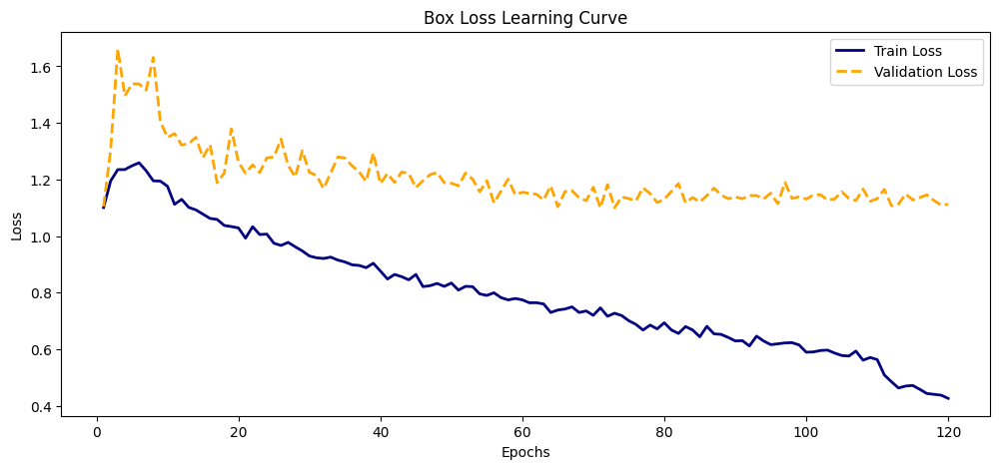

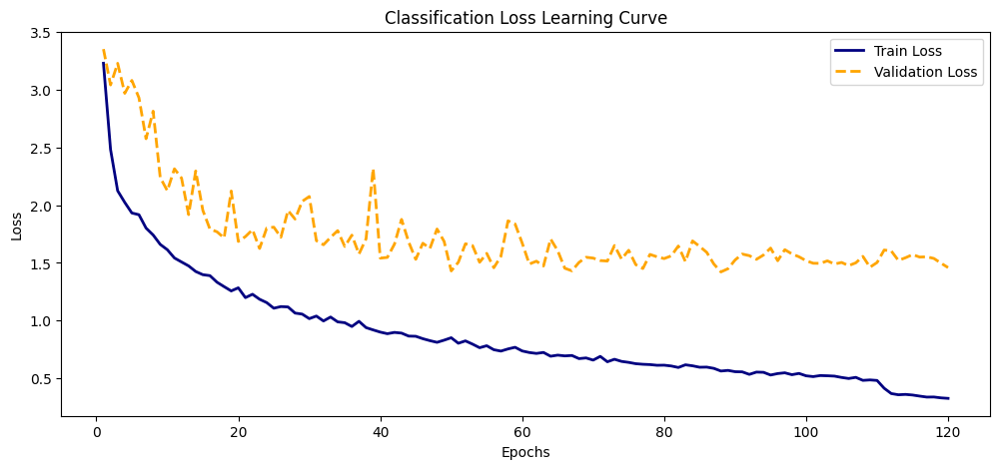

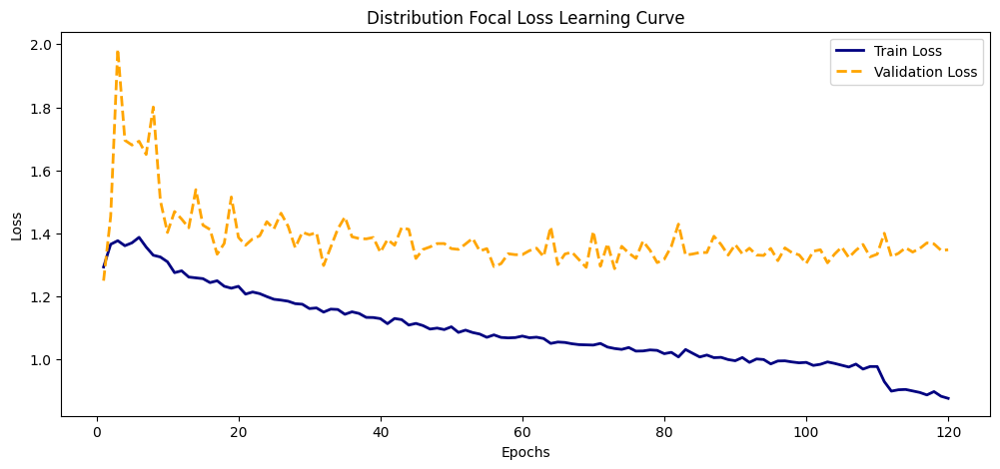

In [22]:
# Create the full file path for 'results.csv' using the directory path and file name
results_csv_path = os.path.join(post_training_files_path, 'results.csv')

# Load the CSV file from the constructed path into a pandas DataFrame
df = pd.read_csv(results_csv_path)

# Remove any leading whitespace from the column names
df.columns = df.columns.str.strip()

# Plot the learning curves for each loss
plot_learning_curve(df, 'train/box_loss', 'val/box_loss', 'Box Loss Learning Curve')
plot_learning_curve(df, 'train/cls_loss', 'val/cls_loss', 'Classification Loss Learning Curve')
plot_learning_curve(df, 'train/dfl_loss', 'val/dfl_loss', 'Distribution Focal Loss Learning Curve')

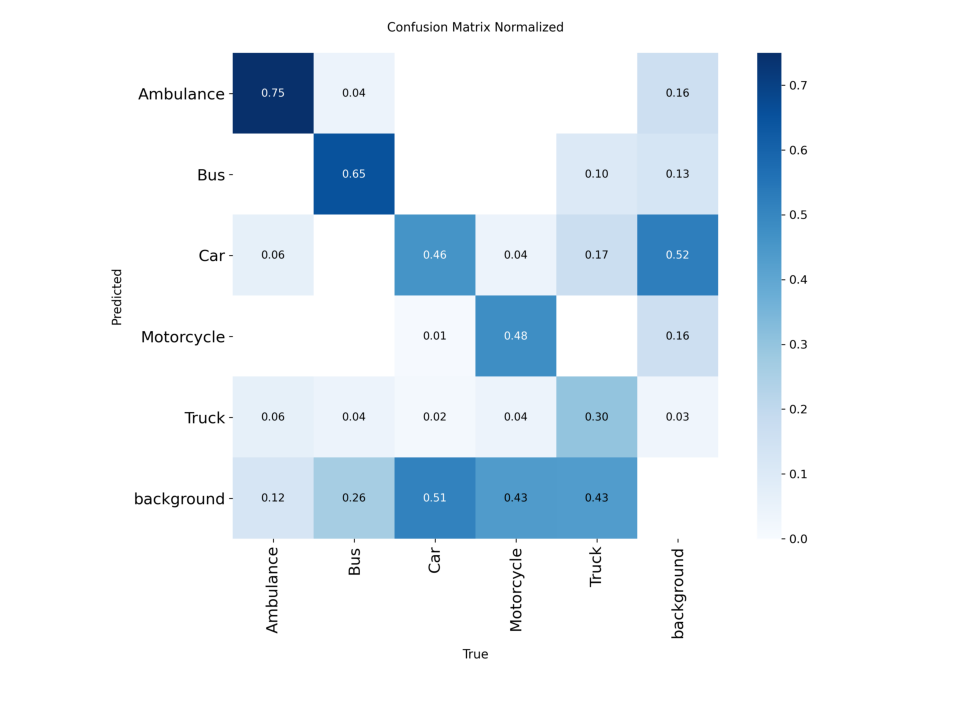

In [23]:
# Construct the path to the normalized confusion matrix image
confusion_matrix_path = os.path.join(post_training_files_path, 'confusion_matrix_normalized.png')

# Read the image using cv2
cm_img = cv2.imread(confusion_matrix_path)

# Convert the image from BGR to RGB color space for accurate color representation with matplotlib
cm_img = cv2.cvtColor(cm_img, cv2.COLOR_BGR2RGB)

# Display the image
plt.figure(figsize=(10, 10), dpi=120)
plt.imshow(cm_img)
plt.axis('off')
plt.show()


In [24]:
# Construct the path to the best model weights file using os.path.join
best_model_path_yolo_detect = os.path.join(post_training_files_path, 'weights/best.pt')

# Load the best model weights into the YOLO model
best_model_yolo_detect = YOLO(best_model_path_yolo_detect)

# Validate the best model using the validation set with default parameters
metrics_yolo_detect = best_model_yolo_detect.val(split='val')

Ultralytics 8.3.167 🚀 Python-3.11.13 torch-2.6.0+cu124 CUDA:0 (Tesla T4, 15095MiB)
YOLO11n summary (fused): 100 layers, 2,583,127 parameters, 0 gradients, 6.3 GFLOPs
val: Fast image access ✅ (ping: 0.0±0.0 ms, read: 58.7±34.5 MB/s, size: 31.0 KB)


val: Scanning /kaggle/input/vehicledetection/VehiclesDetectionDataset/valid/labels... 250 images, 0 backgrounds, 0 corrupt: 100%|██████████| 250/250 [00:00<00:00, 555.86it/s]

WARNING ⚠️ val: Cache directory /kaggle/input/vehicledetection/VehiclesDetectionDataset/valid is not writeable, cache not saved.



                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 16/16 [00:02<00:00,  5.87it/s]


                   all        250        454      0.691      0.515       0.59      0.455
             Ambulance         50         64      0.799       0.75      0.855      0.779
                   Bus         30         46      0.754      0.667      0.724      0.584
                   Car         90        238      0.708      0.412      0.486      0.333
            Motorcycle         42         46      0.671      0.478      0.543       0.33
                 Truck         38         60      0.522      0.267      0.343      0.248
Speed: 0.5ms preprocess, 2.8ms inference, 0.0ms loss, 1.5ms postprocess per image
Results saved to runs/detect/val2


 <p style="color:black;font-family:newtimeroman;font-size:250%;text-align:center; font-weight:8000">✅ AS you can see,reults with training a yolo model with transfer learning and usning pretrained data and then fine tune it on our data is much better,now lets test them on real data ✅ </p>


image 1/1 /kaggle/input/vehicledetection/VehiclesDetectionDataset/test/images/a3cffcdbff959432_jpg.rf.4MQ1NmvMx33nwLe9QSvu.jpg: 416x416 1 Truck, 9.7ms
Speed: 2.2ms preprocess, 9.7ms inference, 1.6ms postprocess per image at shape (1, 3, 416, 416)

image 1/1 /kaggle/input/vehicledetection/VehiclesDetectionDataset/test/images/a7674f15d9b1f35f_jpg.rf.pL09u0Oz8DRvTB3AnBXT.jpg: 416x416 1 Ambulance, 9.0ms
Speed: 0.9ms preprocess, 9.0ms inference, 1.3ms postprocess per image at shape (1, 3, 416, 416)

image 1/1 /kaggle/input/vehicledetection/VehiclesDetectionDataset/test/images/aed83d879a22a6c4_jpg.rf.ada6c87c88d32689f79e3a03c9ebd314.jpg: 416x416 (no detections), 8.7ms
Speed: 1.0ms preprocess, 8.7ms inference, 0.6ms postprocess per image at shape (1, 3, 416, 416)

image 1/1 /kaggle/input/vehicledetection/VehiclesDetectionDataset/test/images/a3cffcdbff959432_jpg.rf.1f1f8cfcdfe052a8ec72e63b11889b66.jpg: 416x416 1 Truck, 8.7ms
Speed: 0.8ms preprocess, 8.7ms inference, 1.3ms postprocess per imag

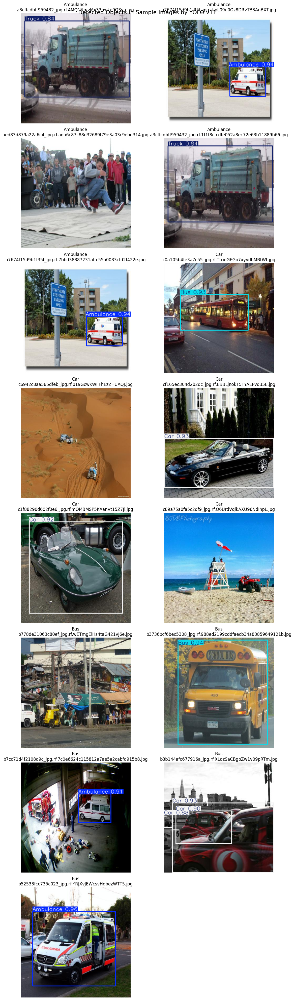

In [25]:
# Load the trained YOLO v11 model
best_model = YOLO("runs/detect/train/weights/best.pt")

# Path to the test image folder from kagglehub
test_images_path = Path(alkanerturan_vehicledetection_path) / "VehiclesDetectionDataset" / "test" / "images"

# Define class mapping based on the first letter in filenames
class_mapping = {
    "A": "Ambulance",
    "C": "Car",
    "M": "Motorcycle",
    "B": "Bus",
    "T": "Truck"
}

# Collect images by class
image_classes = {cls: [] for cls in class_mapping.keys()}

if not test_images_path.exists():
    raise FileNotFoundError(f"Error: The path {test_images_path} does not exist!")

# Categorize images
for img_name in os.listdir(test_images_path):
    if img_name.endswith(('.jpg', '.png', '.jpeg')):
        class_letter = img_name[0].upper()
        if class_letter in image_classes:
            image_classes[class_letter].append(img_name)

# Select 5 images per class
selected_images = []
for class_letter, img_list in image_classes.items():
    selected_images.extend([(class_letter, img) for img in img_list[:5]])

if not selected_images:
    raise ValueError("No images were found matching the class mapping criteria.")

# Prepare plot
num_images = len(selected_images)
num_rows = max(1, (num_images + 1) // 2)

fig, axes = plt.subplots(num_rows, 2, figsize=(12, 5 * num_rows))
axes = axes.flatten() if num_images > 1 else [axes]

# Predict and display
for idx, (class_letter, img_name) in enumerate(selected_images):
    img_path = test_images_path / img_name
    results = best_model.predict(source=str(img_path), imgsz=416, conf=0.7)
    annotated_img = results[0].plot(line_width=2)
    annotated_img = cv2.cvtColor(annotated_img, cv2.COLOR_BGR2RGB)
    axes[idx].imshow(annotated_img)
    axes[idx].set_title(f"{class_mapping[class_letter]}\n{img_name}", fontsize=12)
    axes[idx].axis("off")

# Hide unused axes
for i in range(idx + 1, len(axes)):
    fig.delaxes(axes[i])

plt.suptitle("Detected Objects in Sample Images by YOLO v11", fontsize=16)
plt.tight_layout()
plt.show()

In [28]:
!pip install supervision --upgrade

In [30]:
import cv2
import os
from ultralytics import YOLO
from IPython.display import Video, display
from pathlib import Path

# Load YOLOv11 model
model = YOLO("runs/detect/train/weights/best.pt")

# Correct path to the video
video_path = Path(alkanerturan_vehicledetection_path) / "TestVideo" / "TrafficPolice.mp4"
output_path = "output_TrafficPolice.mp4"
compressed_output_path = "compressed_output_TrafficPolice.mp4"

# Open video
cap = cv2.VideoCapture(str(video_path))
frame_width = int(cap.get(cv2.CAP_PROP_FRAME_WIDTH))
frame_height = int(cap.get(cv2.CAP_PROP_FRAME_HEIGHT))
fps = int(cap.get(cv2.CAP_PROP_FPS))
cap.set(cv2.CAP_PROP_POS_FRAMES, 0)

# Process 30 seconds
max_frames = int(fps * 30)

# Video writer
out = cv2.VideoWriter(output_path, cv2.VideoWriter_fourcc(*'mp4v'), fps, (frame_width, frame_height))
frame_count = 0

while cap.isOpened() and frame_count < max_frames:
    ret, frame = cap.read()
    if not ret:
        break

    # Run YOLO inference
    results = model(frame, conf=0.5, verbose=False)[0]

    for box, cls_id, conf in zip(results.boxes.xyxy, results.boxes.cls, results.boxes.conf):
        x1, y1, x2, y2 = map(int, box)
        label = f"{results.names[int(cls_id)]} {conf:.2f}"
        color = (0, 255, 0)

        cv2.rectangle(frame, (x1, y1), (x2, y2), color, 2)
        cv2.putText(frame, label, (x1, y1 - 10), cv2.FONT_HERSHEY_SIMPLEX, 0.7, color, 2)

    out.write(frame)
    frame_count += 1

cap.release()
out.release()

# Compress output
os.system(f"ffmpeg -y -t 30 -i {output_path} -vcodec libx264 -crf 30 {compressed_output_path}")

# Display video
display(Video(compressed_output_path, embed=True))


 <p style="padding:10px;background-color:green;margin:200;color:black;font-family:newtimeroman;font-size:200%;text-align:center;border-radius: 1500px 500px;overflow:hidden;font-weight:8000">Thanks for supporting me by upvotes😍🤝</p>